In [9]:
from PIL import Image
import os
import random
import cv2
import numpy as np
from matplotlib import pyplot as plt
from tqdm import tqdm


# tensorflow
import tensorflow as tf
from tensorflow.keras.models import Model

# tensorflow layers
from tensorflow.keras import layers, Model
# VGG19
from tensorflow.keras.applications.vgg19 import VGG19

import tensorflow_addons as tfa

## Load Data

In [10]:
def label_to_one_hot(labels, num_classes, repeat):
  now_label_dataset = np.zeros((num_classes))
  now_label_dataset[labels]  = 1
  now_label_dataset = np.expand_dims(now_label_dataset, axis=0)
  now_label_dataset = np.repeat(now_label_dataset, repeats=repeat, axis=0)
  return now_label_dataset

In [11]:
def dataset_packing(path_npy, shuffle = False) :
  dataset = np.load(path_npy)
  # Split into train and validation sets using indexing to optimize memory.
  dataset = dataset/256
  x_dataset = dataset[:,0,:,:,:]
  y_dataset = dataset[:,1,:,:,:]
  rr  = x_dataset.shape[0]
  label_dataset = label_to_one_hot(1,10, rr)

  for i in range(8) :
    x_dataset = np.concatenate((x_dataset, dataset[:,0,:,:,:] ), axis = 0)
    y_dataset = np.concatenate((y_dataset, dataset[:,i+2,:,:,:] ), axis = 0)
    label_dataset = np.concatenate((label_dataset, label_to_one_hot(i + 2,10, rr)), axis = 0)

  print('data set shape----------------')
  print(x_dataset.shape)
  print(y_dataset.shape)
  print(label_dataset.shape)
  indexes = np.arange(x_dataset.shape[0])
  if shuffle :
    np.random.shuffle(indexes)

  x_train = x_dataset[indexes]
  y_train = y_dataset[indexes]
  label_train = label_dataset[indexes]

  print('train_data set shape----------------')
  print(x_train.shape)
  print(y_train.shape)
  print(label_train.shape)

  return x_train, y_train, label_train

In [12]:
import glob

def load_multiple_npy_files(directory_path):
    # directory_path에 있는 모든 .npy 파일 경로 가져오기
    file_paths = glob.glob(f"{directory_path}/*.npy")
    
    # 각 npy 파일을 로드하여 리스트에 추가
    datasets = [np.load(file) for file in file_paths]
    
    # 모든 npy 파일을 하나의 배열로 결합 (첫 번째 축을 기준으로)
    combined_dataset = np.concatenate(datasets, axis=0)
    
    return combined_dataset

In [13]:
combined_dataset = load_multiple_npy_files('Frame_Img/Walk/')   

In [14]:
combined_dataset.shape

(305, 10, 128, 128, 4)

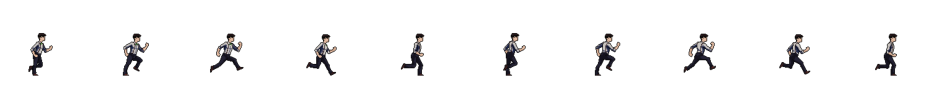

In [15]:
def visualize_rgba_dataset(dataset, batch_index=0, num_frames=10):
    # num_frames 개수만큼 샘플의 프레임을 시각화
    plt.figure(figsize=(12, 6))
    for i in range(num_frames):
        plt.subplot(1, num_frames, i + 1)
        
        # (높이, 넓이, RGBA) 형식으로 프레임을 시각화
        plt.imshow(dataset[batch_index, i])  # 배치와 프레임 선택
        plt.axis('off')
    plt.show()

# 예시로 첫 번째 배치의 처음 5개 프레임 시각화
visualize_rgba_dataset(combined_dataset, batch_index=185, num_frames=10)

## GAN + LSTM
- Image -> Motion GIF (ex. Jump, Walk... etc)
- GAN은 Frame Generate + LSTM은 Sequence를 담당

#### **데이터셋 예시**

| **Input (Character Image)** | **Output (Frame Sequence - JUMP GIF)** |
|-----------------------------|----------------------------------------|
| `character_1.png`           | `jump_1/frame_1.png, jump_1/frame_2.png, ..., jump_1/frame_10.png` |
| `character_2.png`           | `jump_2/frame_1.png, jump_2/frame_2.png, ..., jump_2/frame_10.png` |
| `character_3.png`           | `jump_3/frame_1.png, jump_3/frame_2.png, ..., jump_3/frame_10.png` |
| `character_4.png`           | `jump_4/frame_1.png, jump_4/frame_2.png, ..., jump_4/frame_10.png` |
| `character_5.png`           | `jump_5/frame_1.png, jump_5/frame_2.png, ..., jump_5/frame_10.png` |

#### **설명**
- **Input (Character Image)**: 각 캐릭터의 정적 이미지 파일 이름입니다. 모델의 **입력**으로 사용됩니다.
- **Output (Frame Sequence - JUMP GIF)**: JUMP 동작을 표현하는 **10개의 연속된 프레임 이미지**입니다. 
  - 예를 들어, `jump_1` 폴더에는 `frame_1.png`부터 `frame_10.png`까지가 포함되어 있으며, 이는 `character_1.png`와 매칭됩니다.
  - 모든 출력 시퀀스는 동일한 길이의 프레임을 가지며, 이를 통해 모델이 정해진 시퀀스를 학습할 수 있게 됩니다.


Generator
- 독립적으로 입력된 캐릭터와 비슷한 이미지를 생성할 수 있는지 Test

**참고자료**
- https://velog.io/@hayaseleu/Transposed-Convolutional-Layer%EC%9D%80-%EB%AC%B4%EC%97%87%EC%9D%B8%EA%B0%80

In [32]:
class Ayo_Generator(Model):
    """
    Generator Model for GAN
    "이미지를 GIF로 생성하는 모델"
    : Mixture of CNN, Attention Layer, LSTM for Frame Generation
    
    Input:
    - sequence_length: Number of Frames to Generate
    
    Output:
    - Generated Frames (Motion of Train GIF)
    """
    def __init__(self, sequence_length=7):
        super(Ayo_Generator, self).__init__()
        self.sequence_length = sequence_length

        # UNet Encoder
        self.encoder_layers = [
            layers.Conv2D(64, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.Conv2D(128, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.Conv2D(256, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.Conv2D(512, kernel_size=4, strides=2, padding='same', activation='relu')
        ]

        # Dense layer to reduce features for LSTM input
        self.reduce_features = layers.Dense(128, activation='relu')

        # Frame index embedding layer
        self.frame_embedding = layers.Embedding(input_dim=10, output_dim=128)

        # Dense layer to match LSTM output to decoder input shape
        self.expand_layer = layers.Dense(16 * 16 * 128, activation='relu')

        # UNet Decoder with skip connections
        self.decoder_layers = [
            layers.Conv2DTranspose(256, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.Conv2DTranspose(64, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.Conv2DTranspose(4, kernel_size=4, strides=1, padding='same', activation='tanh')
        ]

        # Layers to match skip connection channels
        self.match_channels_layers = [
            layers.Conv2D(256, kernel_size=1, padding='same'),
            layers.Conv2D(128, kernel_size=1, padding='same'),
            layers.Conv2D(64, kernel_size=1, padding='same')
        ]


    def call(self, input_image, frame_index):
        x = input_image
        skip_connections = []

        # Encoder with skip connections
        for layer in self.encoder_layers:
            x = layer(x)
            skip_connections.append(x)

        # Flatten and reduce to match LSTM input size
        features = tf.keras.layers.Flatten()(x)
        features = self.reduce_features(features)  # (batch_size, 128)

        # Expand frame_index to match the batch size
        frame_index = tf.reshape(frame_index, (-1, 1))  # Reshape to (batch_size, 1)
        frame_embedding = self.frame_embedding(frame_index)  # Get embeddings
        frame_embedding = tf.squeeze(frame_embedding, axis=1)  # Remove extra dimension after embedding

        # Concatenate features with frame embedding
        combined_features = tf.concat([features, frame_embedding], axis=-1)

        # Expand combined features to decoder input shape
        lstm_output_expanded = self.expand_layer(combined_features)
        x = tf.reshape(lstm_output_expanded, (-1, 16, 16, 128))

        # Decoder with skip connections
        for i, layer in enumerate(self.decoder_layers):
            if i < len(skip_connections):
                skip_connection = skip_connections[-(i + 1)]
                if i < len(self.match_channels_layers):
                    skip_connection = self.match_channels_layers[i](skip_connection)
                skip_connection = tf.image.resize(skip_connection, tf.shape(x)[1:3])
                x = tf.concat([x, skip_connection], axis=-1)
            x = layer(x)

        return x  # Return a single frame




class Ayo_Discriminator(Model):
    def __init__(self):
        super(Ayo_Discriminator, self).__init__()
        self.conv = tf.keras.Sequential([
            layers.Conv2D(64, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.Conv2D(128, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.Conv2D(256, kernel_size=4, strides=2, padding='same', activation='relu'),
            layers.BatchNormalization(),
            layers.Flatten(),
            layers.Dense(512, activation='relu'),
            layers.Dense(1, activation='sigmoid')
        ])        

    def call(self, input_image, frames):
        # `frames`가 시퀀스인지 개별 프레임인지 확인
        if len(frames.shape) == 5:  # 시퀀스 (batch, sequence_length, height, width, channels)
            batch_size, sequence_length, height, width, channels = frames.shape
            input_resized = tf.image.resize(input_image, [height, width])
            input_resized = tf.expand_dims(input_resized, axis=1)
            input_resized = tf.tile(input_resized, [1, sequence_length, 1, 1, 1])
            
            outputs = []
            for i in range(sequence_length):
                frame = frames[:, i]
                combined = tf.concat([input_resized[:, i], frame], axis=-1)
                combined_resized = tf.image.resize(combined, [64, 64])
                output = self.conv(combined_resized)
                outputs.append(output)
            return tf.reduce_mean(outputs, axis=0)
        
        elif len(frames.shape) == 4:  # 개별 프레임 (batch, height, width, channels)
            batch_size, height, width, channels = frames.shape
            input_resized = tf.image.resize(input_image, [height, width])
            combined = tf.concat([input_resized, frames], axis=-1)
            combined_resized = tf.image.resize(combined, [64, 64])
            return self.conv(combined_resized)



batch_size = 32

def build_vgg19_perceptual_loss():
    vgg = VGG19(weights="imagenet", include_top=False, input_shape=(128, 128, 3))
    selected_layer = ['block4_conv2']
    outputs = [vgg.get_layer(name).output for name in selected_layer]
    model = Model(inputs=vgg.input, outputs=outputs)
    model.trainable = False
    
    return model

vgg_for_perceptual_loss = build_vgg19_perceptual_loss()    
    
# Loss Functions
bce_loss = tf.keras.losses.BinaryCrossentropy(from_logits=False)

def perceptual_loss(real_images, generated_images, perceptual_weight=0.1):
    # real_images와 generated_images의 shape 확인 및 4차원인지 5차원인지에 따른 처리
    if len(real_images.shape) == 5:  # 시퀀스인 경우 (batch_size, sequence_length, height, width, channels)
        sequence_length = real_images.shape[1]
        
        # 각 프레임에 대해 Perceptual Loss를 계산
        perc_loss = 0
        for i in range(sequence_length):
            real_frame = real_images[:, i, :, :, :3]  # 첫 3 채널(RGB)만 선택
            generated_frame = generated_images[:, i, :, :, :3]  # 첫 3 채널(RGB)만 선택
            
            real_features = vgg_for_perceptual_loss(real_frame)
            generated_features = vgg_for_perceptual_loss(generated_frame)
            
            perc_loss += tf.reduce_mean(tf.square(real_features - generated_features))

        # 프레임 수에 따라 평균 내기
        perc_loss = perc_loss / sequence_length * perceptual_weight
        return perc_loss

    elif len(real_images.shape) == 4:  # 단일 프레임인 경우 (batch_size, height, width, channels)
        real_features = vgg_for_perceptual_loss(real_images[:, :, :, :3])
        generated_features = vgg_for_perceptual_loss(generated_images[:, :, :, :3])
        
        # 단일 프레임에 대한 Perceptual Loss 계산
        perc_loss = tf.reduce_mean(tf.square(real_features - generated_features)) * perceptual_weight
        return perc_loss

    
def generator_loss(fake_output, real_images, generated_images, sim_weight=1.0, consistency_weight=1.0, perceptual_weight=0.1):
    bce = bce_loss(tf.ones_like(fake_output), fake_output)
    frame_sim_loss = tf.reduce_mean(tf.square(real_images - generated_images)) * sim_weight

    # Temporal Consistency Loss
    consistency_loss = tf.reduce_mean(
        [tf.square(generated_images[:, i+1] - generated_images[:, i]) for i in range(generated_images.shape[1] - 1)]
    ) * consistency_weight

    # Perceptual Loss 추가
    perc_loss = perceptual_loss(real_images, generated_images, perceptual_weight)

    return bce + frame_sim_loss + consistency_loss + perc_loss


def discriminator_loss(real_output, fake_output):
    real_loss = bce_loss(tf.ones_like(real_output), real_output)
    fake_loss = bce_loss(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

# Optimizers
generator_optimizer = tf.keras.optimizers.Adam(learning_rate = 0.0001, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate = 0.0001, beta_1=0.5)

num_frames = 10
generators = [Ayo_Generator(sequence_length=1) for _ in range(num_frames)]
discriminators = [Ayo_Discriminator() for _ in range(num_frames)]


# Training Step
def train_step_per_frame(generators, discriminators, real_images, input_image):
    batch_size = real_images.shape[0]
    gen_losses = []
    disc_losses = []

    for frame_index in range(num_frames):
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            # 각 프레임에 대한 Generator와 Discriminator 사용
            generated_frame = generators[frame_index](input_image, tf.constant([frame_index] * batch_size))
            real_frame = real_images[:, frame_index]

            if frame_index == 0:
                continue  # 첫 번째 프레임은 입력 이미지와 동일하므로 스킵
            
            real_output = discriminators[frame_index](input_image, real_frame)
            fake_output = discriminators[frame_index](input_image, generated_frame)

            # 프레임 유사성 손실과 시간 일관성 손실 계산
            gen_loss = generator_loss(fake_output, real_frame, generated_frame)
            disc_loss = discriminator_loss(real_output, fake_output)

            gen_losses.append(gen_loss)
            disc_losses.append(disc_loss)

        # 프레임별로 Generator와 Discriminator 가중치 업데이트
        gradients_of_generator = gen_tape.gradient(gen_loss, generators[frame_index].trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminators[frame_index].trainable_variables)

        generator_optimizer.apply_gradients(zip(gradients_of_generator, generators[frame_index].trainable_variables))
        discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminators[frame_index].trainable_variables))

    avg_gen_loss = tf.reduce_mean(gen_losses)
    avg_disc_loss = tf.reduce_mean(disc_losses)

    # print(f"Generator Loss: {avg_gen_loss.numpy()}, Discriminator Loss: {avg_disc_loss.numpy()}")
    return avg_gen_loss, avg_disc_loss




# Dataset Preparation
def load_real_data(combined_data, target_frames=10):
    # tf.data.Dataset API 사용하여 배치 로드 최적화
    def preprocess(data):
        data = tf.cast(data, tf.float32) / 127.5 - 1  # [-1, 1] 스케일링
        return data

    dataset = tf.data.Dataset.from_tensor_slices(combined_data)
    dataset = dataset.map(preprocess, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(tf.data.AUTOTUNE)
    return dataset


def visualize_sample(input_image, real_frames, generated_frames, epoch, batch_index, sequence_length=10):
    """
    Input 이미지와 생성된 Output 프레임을 시각화하여 확인
    """
    fig, axes = plt.subplots(3, sequence_length, figsize=(sequence_length * 2, 6))
    
    # 첫 번째 행: Input Image 한 장만 표시
    input_img = (input_image[0].numpy() + 1) / 2  # [-1, 1] 범위를 [0, 1]로 변환
    for i in range(sequence_length):
        if i == 0:
            axes[0, i].imshow(input_img)
            axes[0, i].set_title(f"Epoch {epoch}, Batch {batch_index} - Input")
        else:
            axes[0, i].axis('off')  # 나머지 칸은 비워둠

    # 두 번째 행: Real Output Frames (실제 타겟 프레임들) 10장 모두 표시
    for idx in range(sequence_length):
        frame = (real_frames[0, idx].numpy() + 1) / 2
        axes[1, idx].imshow(frame)
        axes[1, idx].set_title(f"Real Frame {idx + 1}")
        axes[1, idx].axis('off')

    # 세 번째 행: Generated Frames (생성된 프레임들) 10장
    for idx in range(sequence_length):
        frame = (generated_frames[0, idx].numpy() + 1) / 2
        axes[2, idx].imshow(frame)
        axes[2, idx].set_title(f"Generated Frame {idx + 1}")
        axes[2, idx].axis('off')
    
    plt.tight_layout()
    plt.show()
    

def train_gan_per_frame(generators, discriminator, combined_data, epochs=5, target_frames=10, batch_size=64):
    gen_losses = []
    disc_losses = []

    # TensorFlow Dataset 구성
    dataset = tf.data.Dataset.from_tensor_slices(combined_data).batch(batch_size)

    for epoch in range(epochs):
        print(f"Epoch {epoch + 1}/{epochs}")
        batch_progress = tqdm(enumerate(dataset), total=len(dataset), desc=f"Processing Epoch {epoch + 1}/{epochs}", leave=False)
        
        for batch_index, real_images in batch_progress:
            real_images = tf.cast(real_images, tf.float32) / 127.5 - 1  # [-1, 1] 스케일링
            initial_image = real_images[:, 0]  # (batch_size, H, W, C), 첫 번째 프레임만 사용

            # 학습 단계 실행
            gen_loss, disc_loss = train_step_per_frame(generators, discriminator, real_images, initial_image)
            gen_losses.append(gen_loss.numpy())
            disc_losses.append(disc_loss.numpy())
            
            batch_progress.set_postfix({'Generator Loss': gen_loss.numpy(), 'Discriminator Loss': disc_loss.numpy()})

            # 10개 프레임 생성 및 시각화 (배치 인덱스 10 단위로 시각화)
            if batch_index % 20 == 0:
                generated_frames = [generators[i](initial_image, tf.constant([i] * batch_size)) for i in range(target_frames)]
                generated_frames = tf.stack(generated_frames, axis=1)  # (batch_size, target_frames, H, W, C)
                
                visualize_sample(initial_image, real_images, generated_frames, epoch + 1, batch_index, target_frames)
            
        # # 매 50번째 에포크마다 생성된 샘플 확인
        # if (epoch + 1) % 50 == 0:
        #     print(f"\nEpoch {epoch + 1}/{epochs} - Generator Loss: {gen_loss.numpy()}, Discriminator Loss: {disc_loss.numpy()}")

    # 손실 그래프 표시
    plt.figure(figsize=(10, 5))
    plt.plot(gen_losses, label='Generator Loss')
    plt.plot(disc_losses, label='Discriminator Loss')
    plt.legend()
    plt.title('Training Loss Over Epochs')
    plt.show()





def visualize_generated_images(generator, input_image, epoch, sequence_length=10):
    # Generator를 통해 프레임 생성
    generated_frames = generator(input_image)

    # 생성된 프레임들을 시각화하고 저장
    fig, axes = plt.subplots(1, sequence_length, figsize=(sequence_length * 2, 4))
    for i in range(sequence_length):
        frame = (generated_frames[0, i].numpy() + 1) / 2  # [-1, 1] 범위를 [0, 1]로 변환
        axes[i].imshow(frame)
        axes[i].axis('off')
    plt.suptitle(f"Generated Frames at Epoch {epoch}")
    plt.tight_layout()
    # plt.savefig(f"{save_path}/generated_epoch_{epoch}.png")  # 에포크별 이미지 저장
    plt.show()

Num GPUs Available:  1
Epoch 1/110


Processing Epoch 1/110:   0%|          | 0/5 [00:23<?, ?it/s, Generator Loss=11.7, Discriminator Loss=1.4]

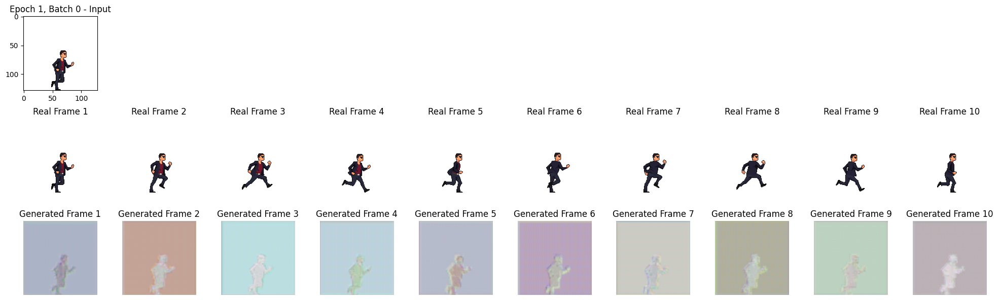

Epoch 2/110


Processing Epoch 2/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=15.4, Discriminator Loss=0.0349]

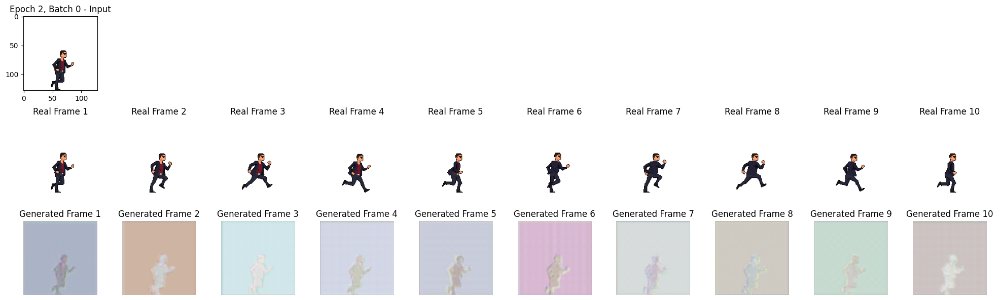

Epoch 3/110


Processing Epoch 3/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=15.1, Discriminator Loss=0.447]

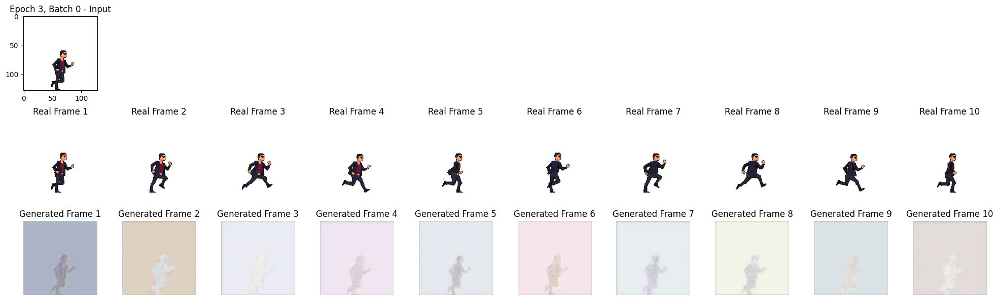

Epoch 4/110


Processing Epoch 4/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=16.4, Discriminator Loss=7.25]

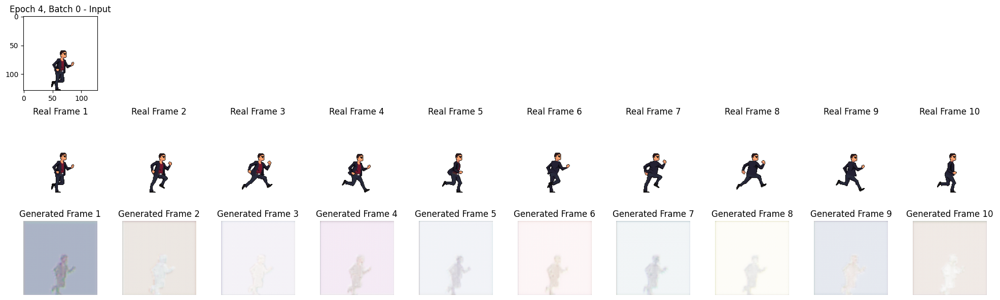

Epoch 5/110


Processing Epoch 5/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=8.76, Discriminator Loss=0.92]

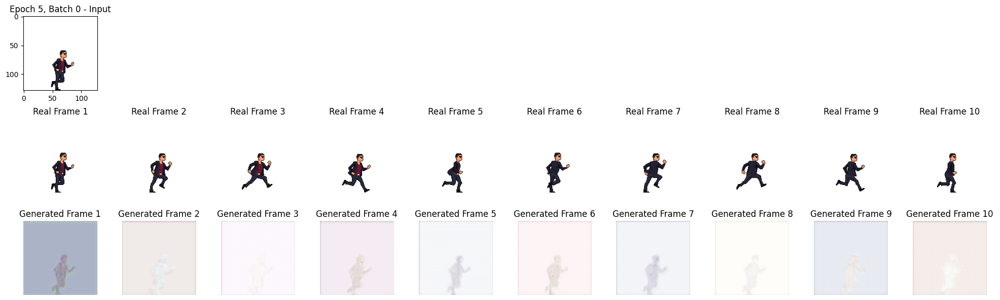

Epoch 6/110


Processing Epoch 6/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=8, Discriminator Loss=1.04]

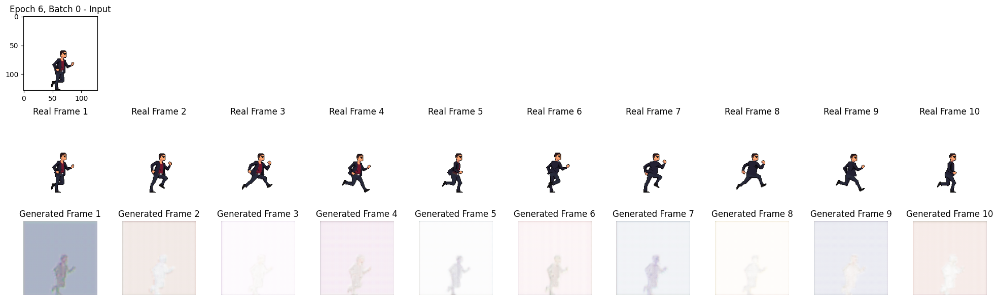

Epoch 7/110


Processing Epoch 7/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=7.52, Discriminator Loss=0.697]

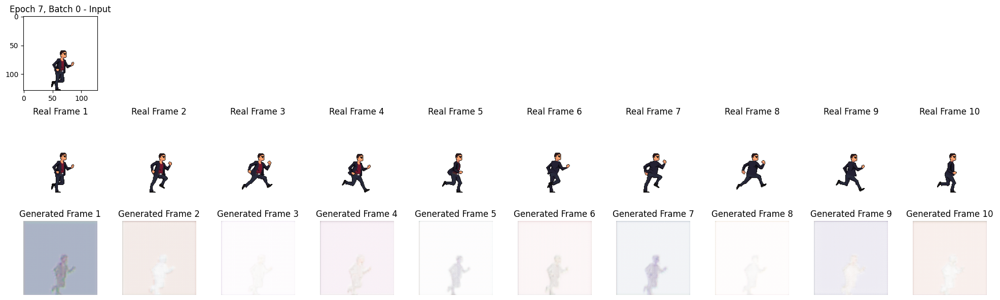

Epoch 8/110


Processing Epoch 8/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=7.71, Discriminator Loss=0.584]

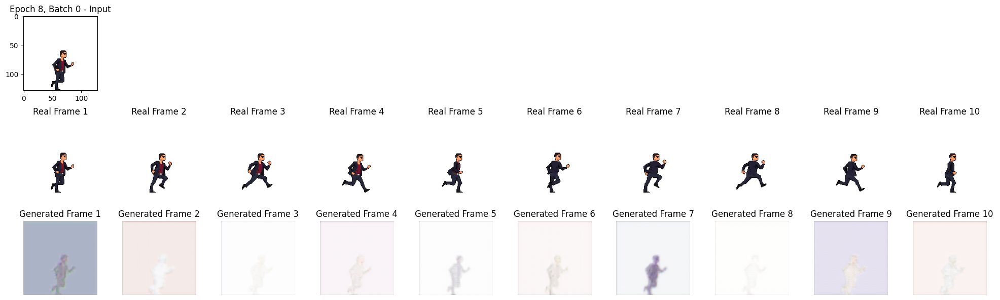

Epoch 9/110


Processing Epoch 9/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=7.99, Discriminator Loss=1.19]

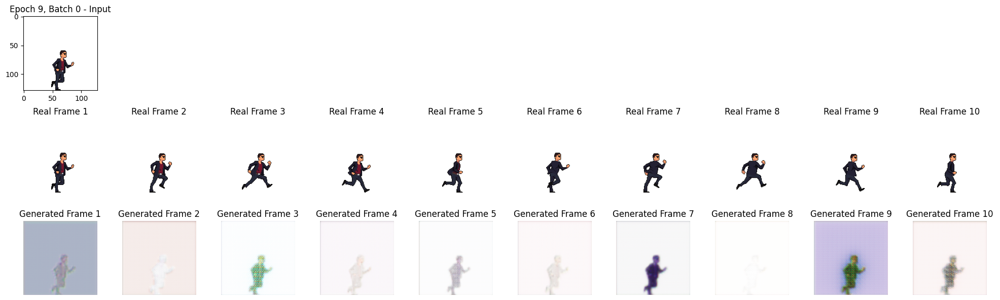

Epoch 10/110


Processing Epoch 10/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=7.32, Discriminator Loss=1.48]

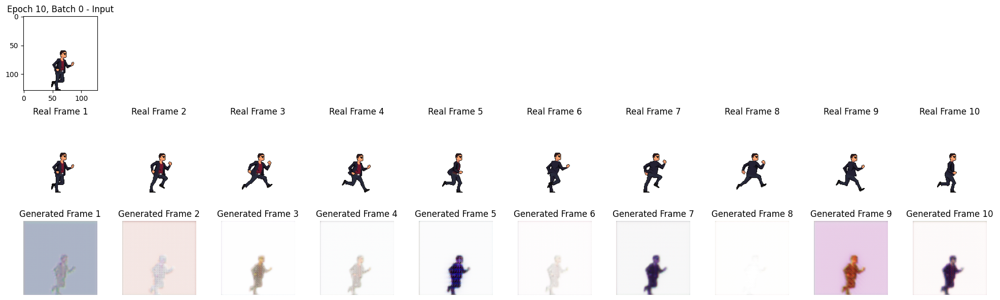

Epoch 11/110


Processing Epoch 11/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=7.01, Discriminator Loss=1.68]

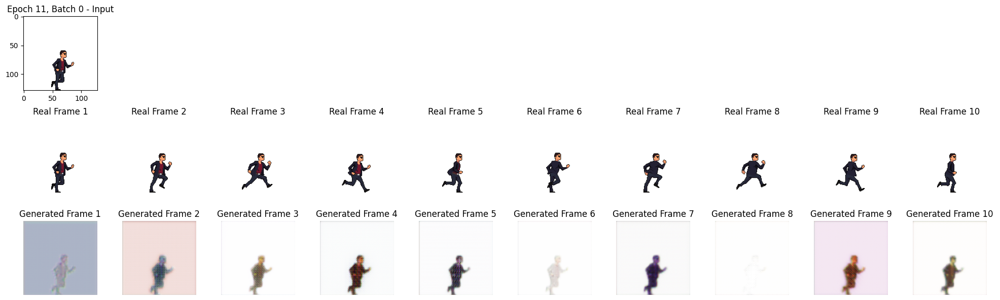

Epoch 12/110


Processing Epoch 12/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=5.83, Discriminator Loss=1.05]

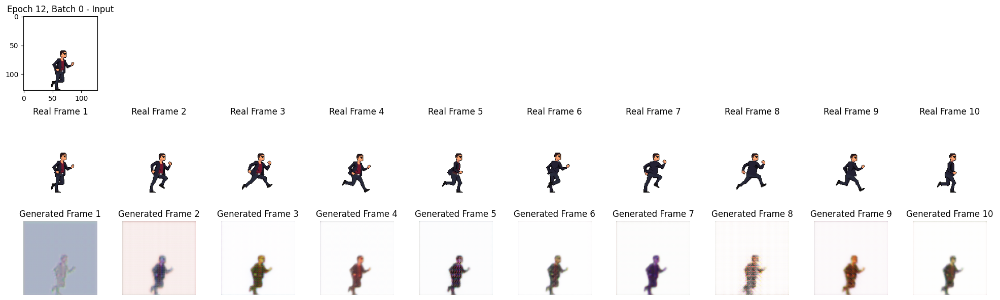

Epoch 13/110


Processing Epoch 13/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=5.69, Discriminator Loss=1.09]

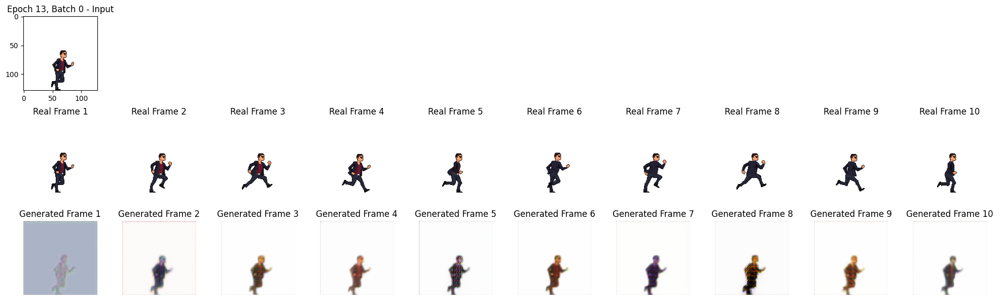

Epoch 14/110


Processing Epoch 14/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=5.14, Discriminator Loss=1.26]

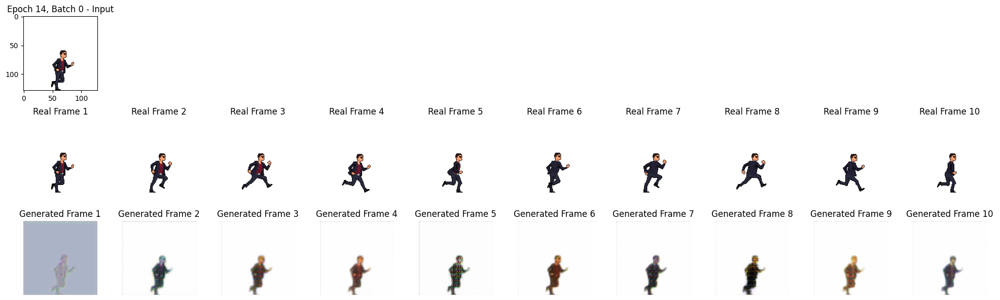

Epoch 15/110


Processing Epoch 15/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=4.99, Discriminator Loss=1.34]

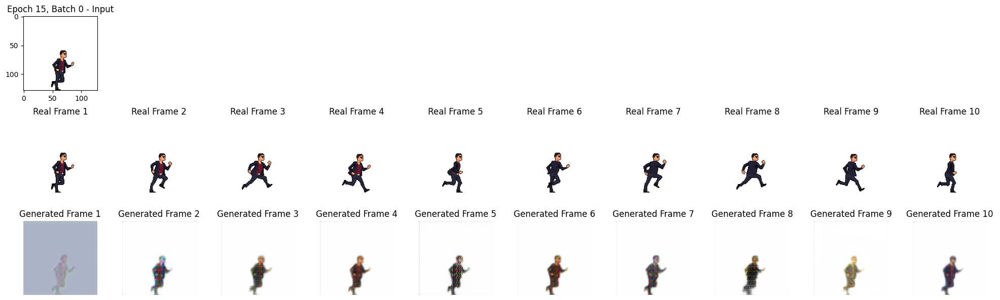

Epoch 16/110


Processing Epoch 16/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=4.78, Discriminator Loss=1.28]

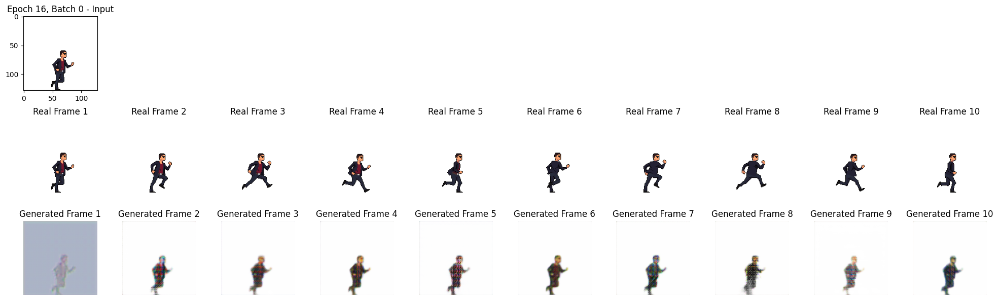

Epoch 17/110


Processing Epoch 17/110:   0%|          | 0/5 [00:09<?, ?it/s, Generator Loss=4.66, Discriminator Loss=1.26]

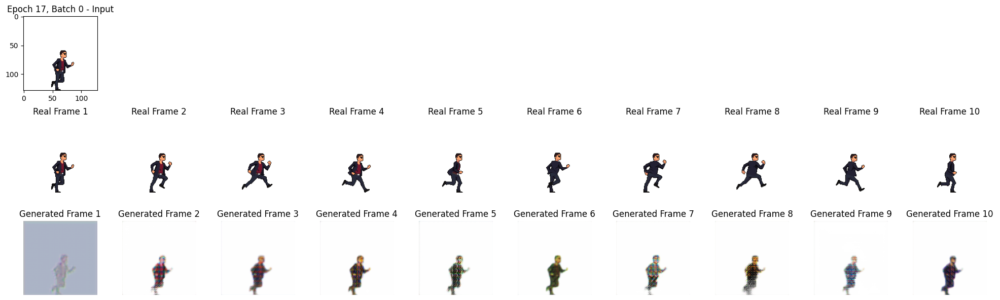

Epoch 18/110


Processing Epoch 18/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.31, Discriminator Loss=1.3]

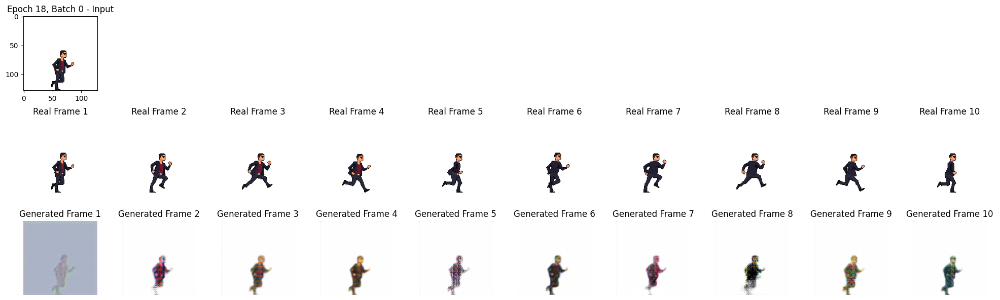

Epoch 19/110


Processing Epoch 19/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.64, Discriminator Loss=1.27]

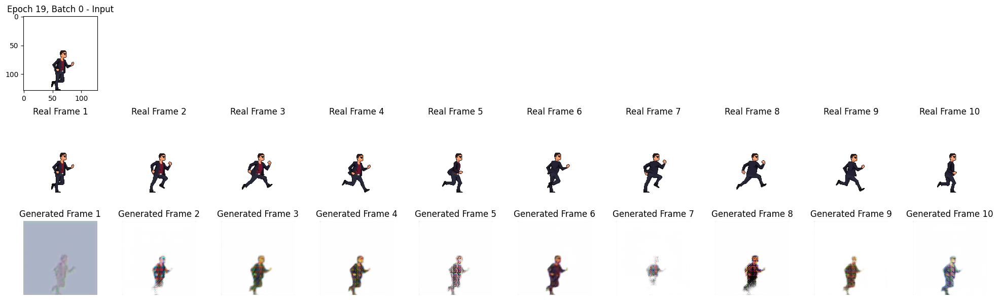

Epoch 20/110


Processing Epoch 20/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.39, Discriminator Loss=1.31]

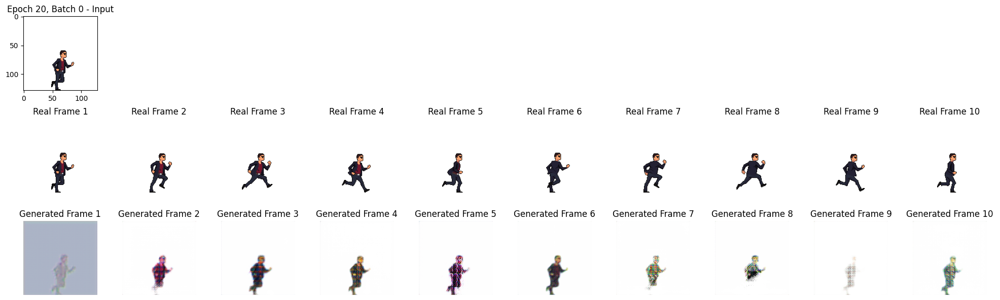

Epoch 21/110


Processing Epoch 21/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.18, Discriminator Loss=1.2]

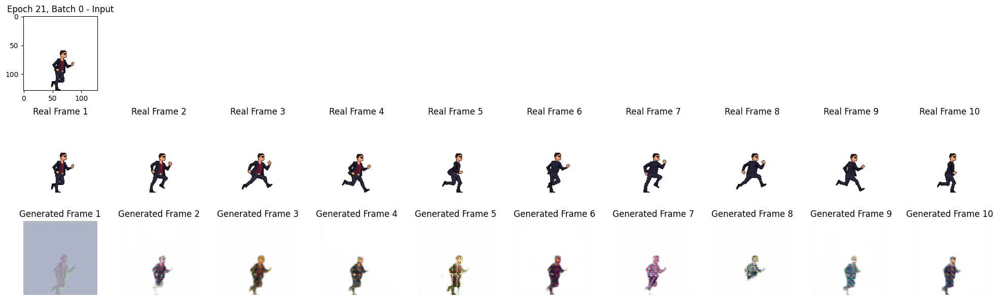

Epoch 22/110


Processing Epoch 22/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.19, Discriminator Loss=1.11]

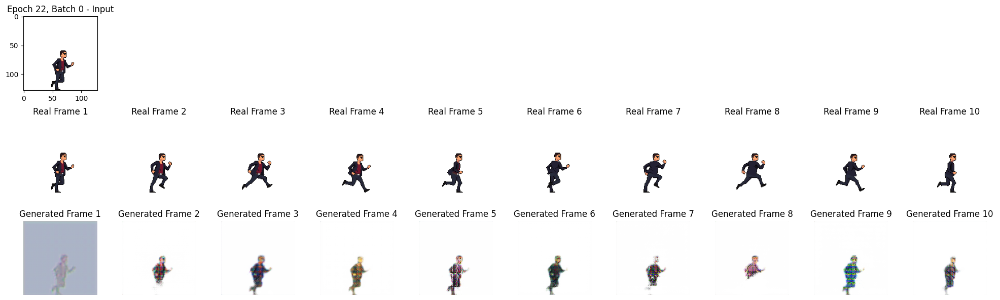

Epoch 23/110


Processing Epoch 23/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.16, Discriminator Loss=1.22]

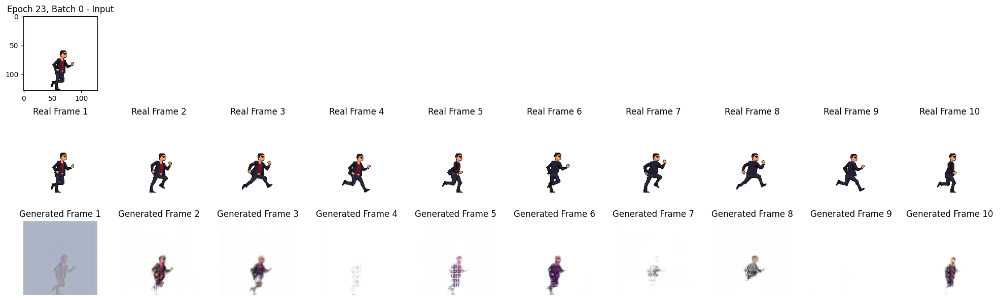

Epoch 24/110


Processing Epoch 24/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.14, Discriminator Loss=1.11]

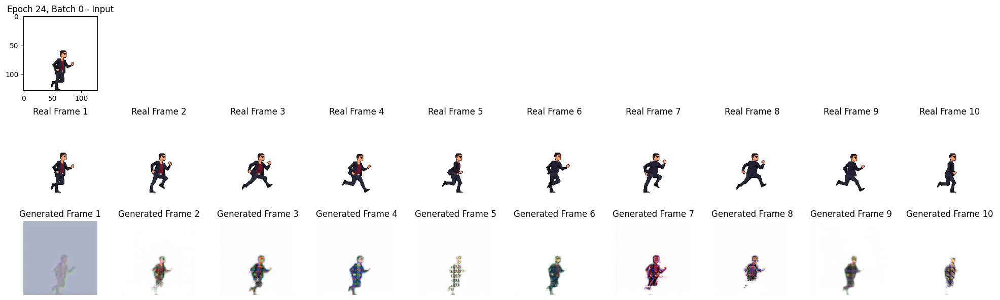

Epoch 25/110


Processing Epoch 25/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.23, Discriminator Loss=1.04]

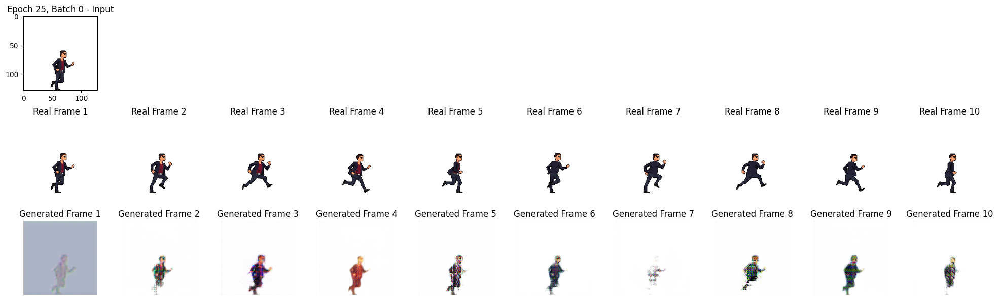

Epoch 26/110


Processing Epoch 26/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.01, Discriminator Loss=1.09]

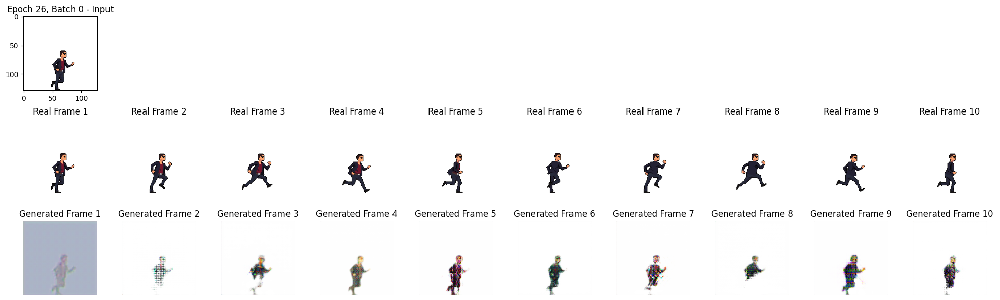

Epoch 27/110


Processing Epoch 27/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.23, Discriminator Loss=1.2]

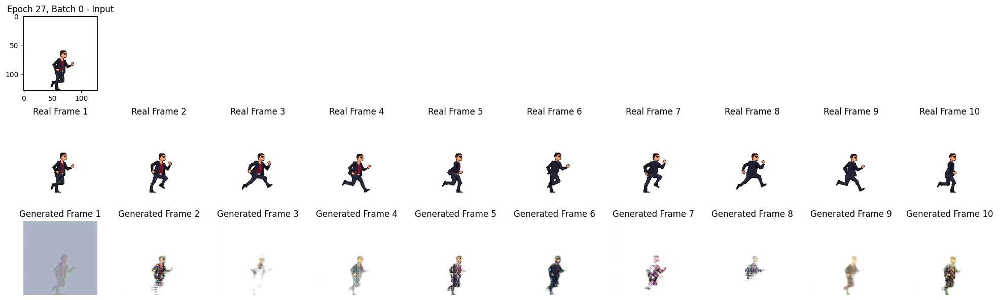

Epoch 28/110


Processing Epoch 28/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.92, Discriminator Loss=1.13]

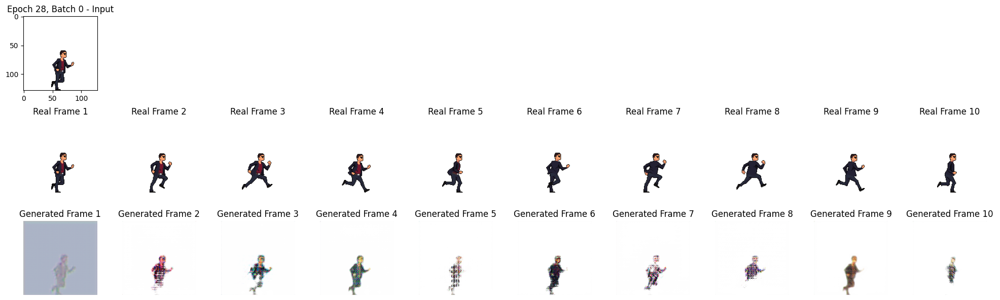

Epoch 29/110


Processing Epoch 29/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.92, Discriminator Loss=1.1]

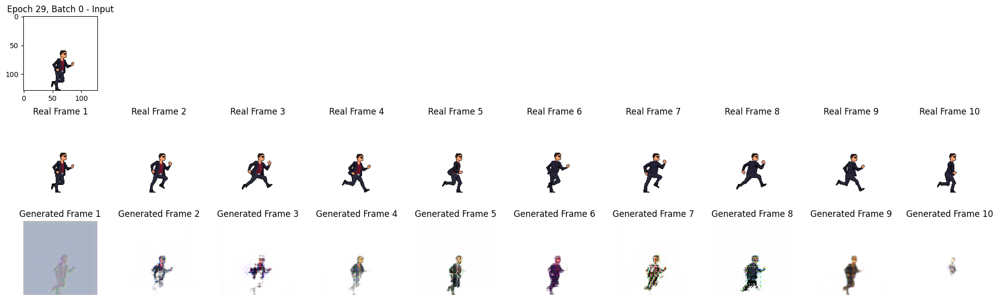

Epoch 30/110


Processing Epoch 30/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=4.06, Discriminator Loss=1.19]

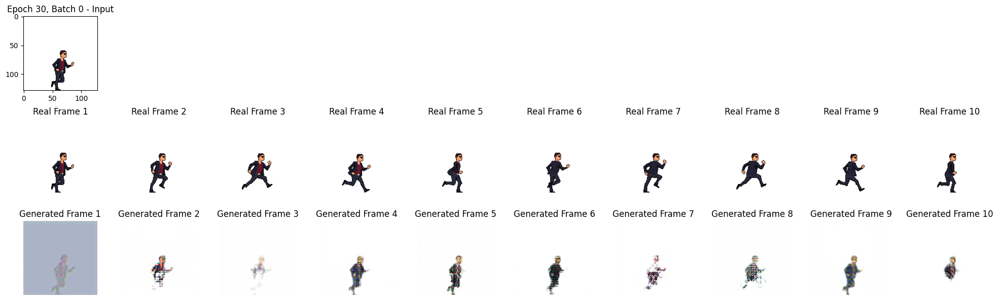

Epoch 31/110


Processing Epoch 31/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.7, Discriminator Loss=1.03]

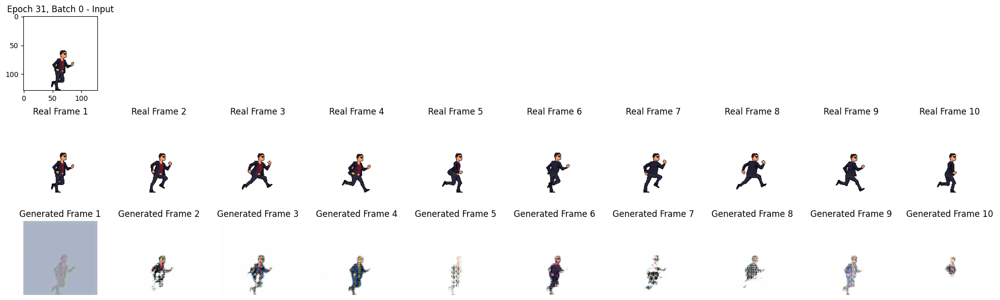

Epoch 32/110


Processing Epoch 32/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.76, Discriminator Loss=1.16]

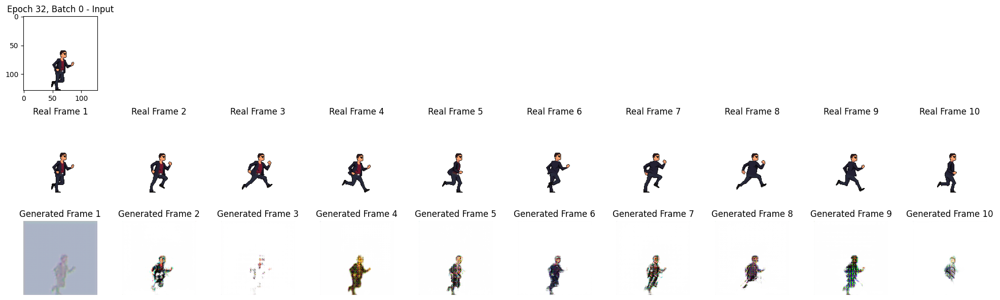

Epoch 33/110


Processing Epoch 33/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.57, Discriminator Loss=1.09]

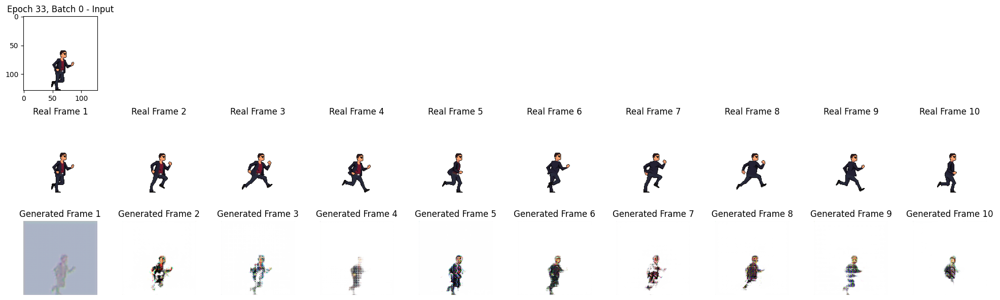

Epoch 34/110


Processing Epoch 34/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.55, Discriminator Loss=1.13]

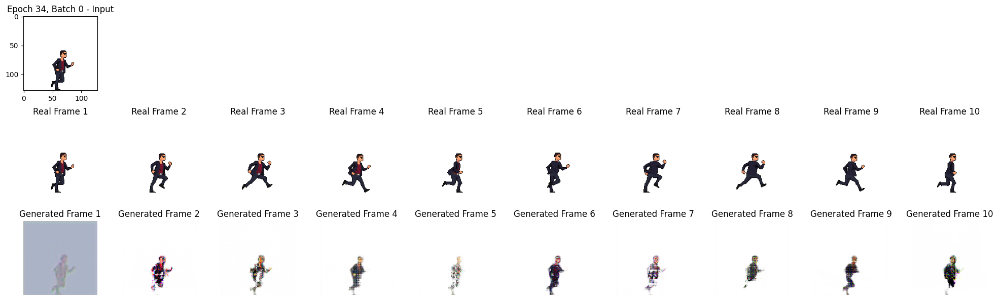

Epoch 35/110


Processing Epoch 35/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.69, Discriminator Loss=0.857]

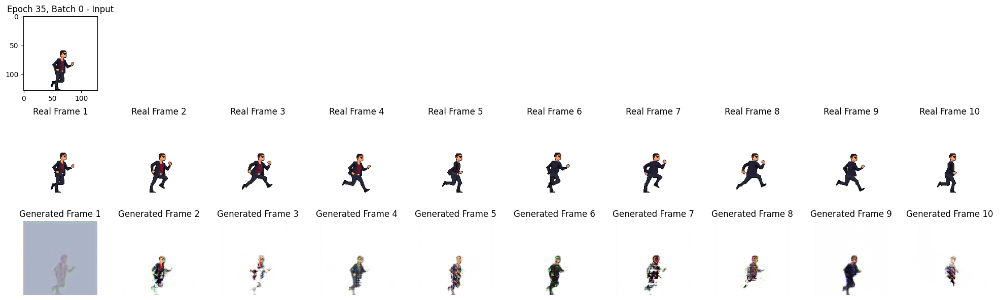

Epoch 36/110


Processing Epoch 36/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.65, Discriminator Loss=1.04]

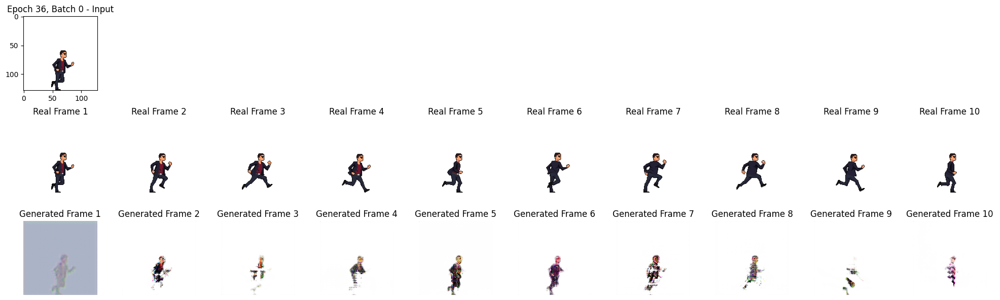

Epoch 37/110


Processing Epoch 37/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.71, Discriminator Loss=1.1]

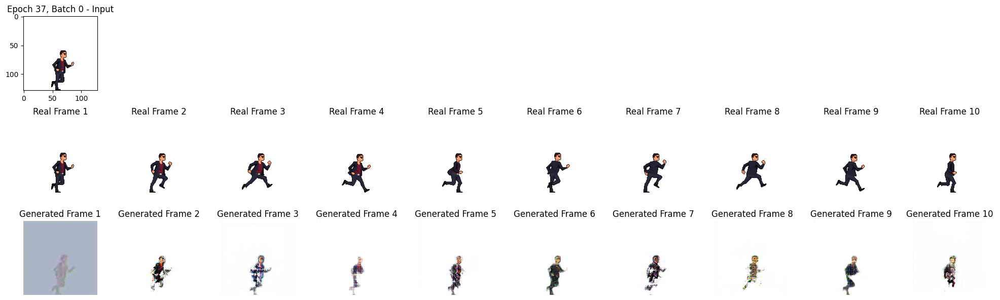

Epoch 38/110


Processing Epoch 38/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.66, Discriminator Loss=0.942]

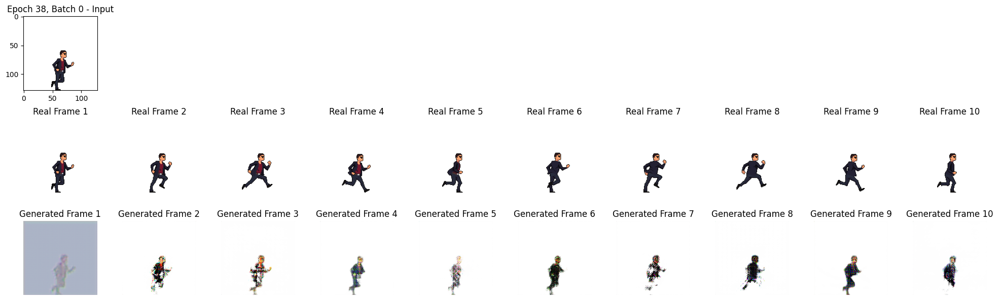

Epoch 39/110


Processing Epoch 39/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.48, Discriminator Loss=0.988]

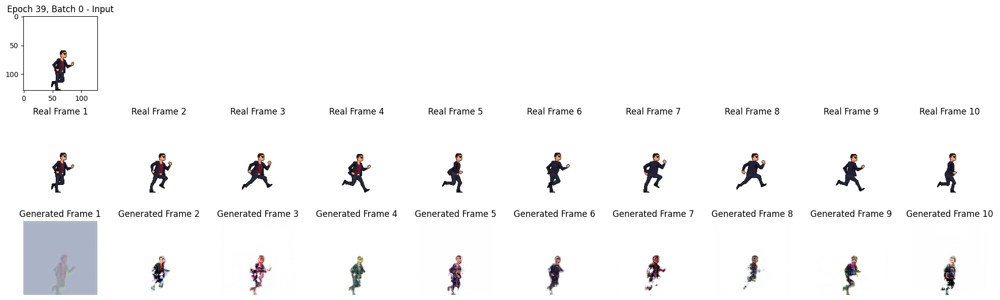

Epoch 40/110


Processing Epoch 40/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.63, Discriminator Loss=1.07]

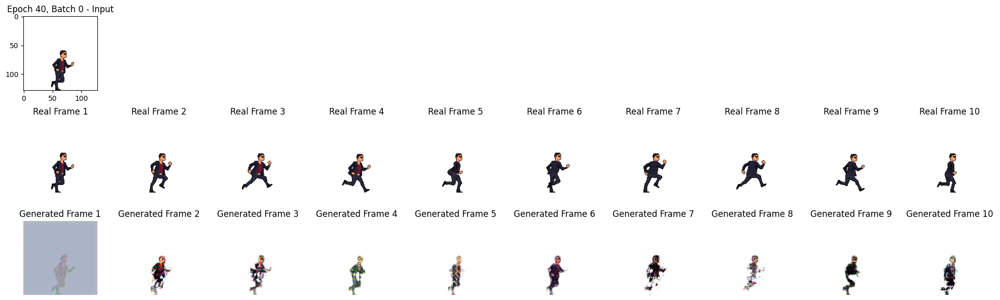

Epoch 41/110


Processing Epoch 41/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.62, Discriminator Loss=1.02]

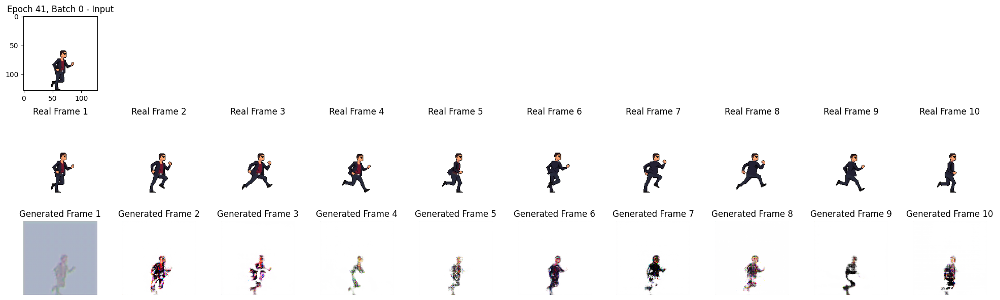

Epoch 42/110


Processing Epoch 42/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.46, Discriminator Loss=1.02]

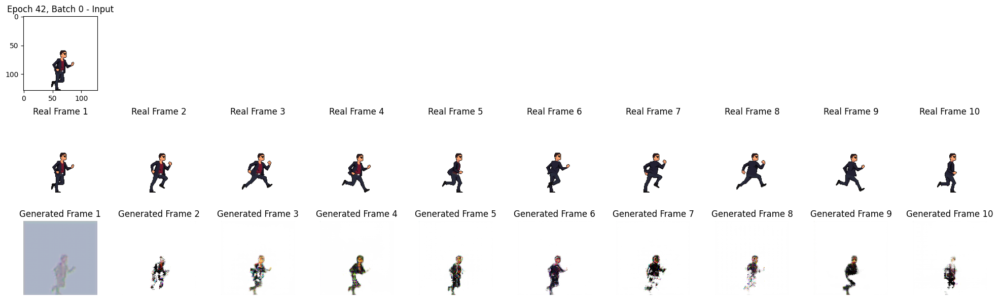

Epoch 43/110


Processing Epoch 43/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.48, Discriminator Loss=1.14]

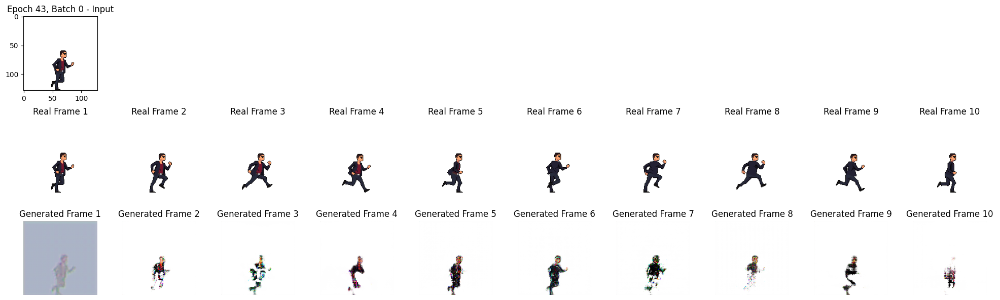

Epoch 44/110


Processing Epoch 44/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.21, Discriminator Loss=1.11]

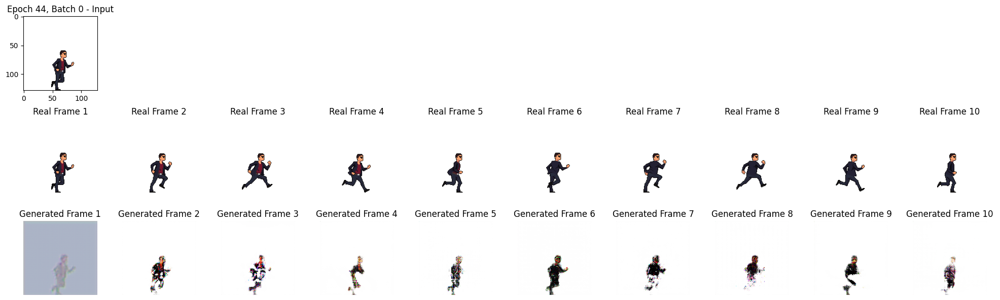

Epoch 45/110


Processing Epoch 45/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.94, Discriminator Loss=1.13]

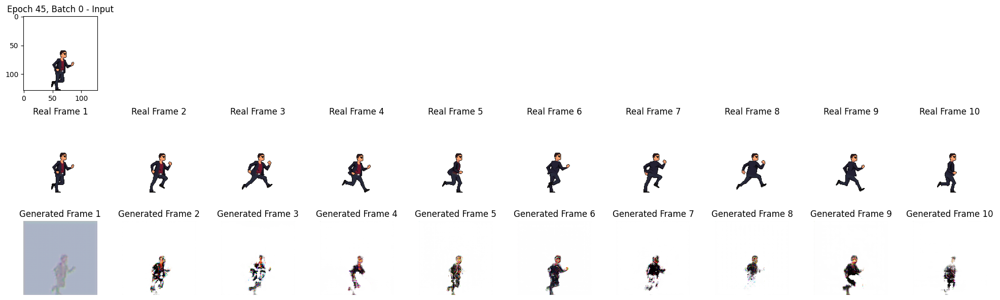

Epoch 46/110


Processing Epoch 46/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.35, Discriminator Loss=1.14]

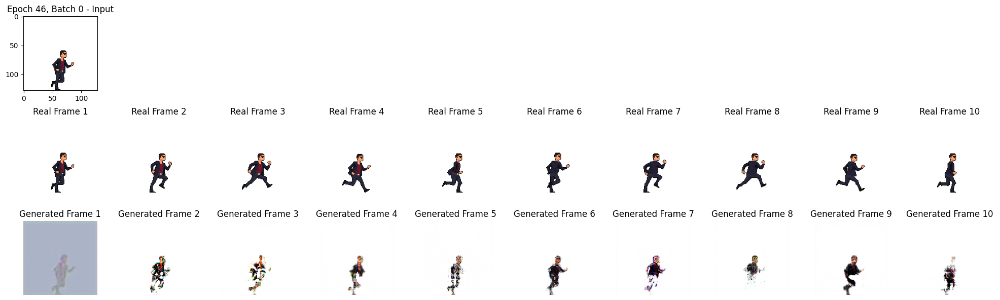

Epoch 47/110


Processing Epoch 47/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.93, Discriminator Loss=1.27]

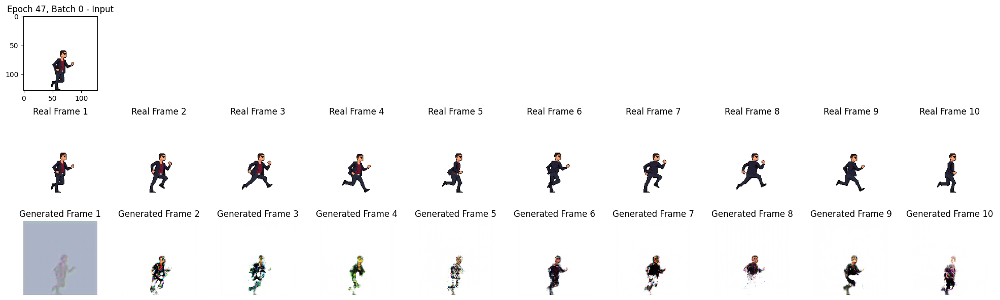

Epoch 48/110


Processing Epoch 48/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.22, Discriminator Loss=1.03]

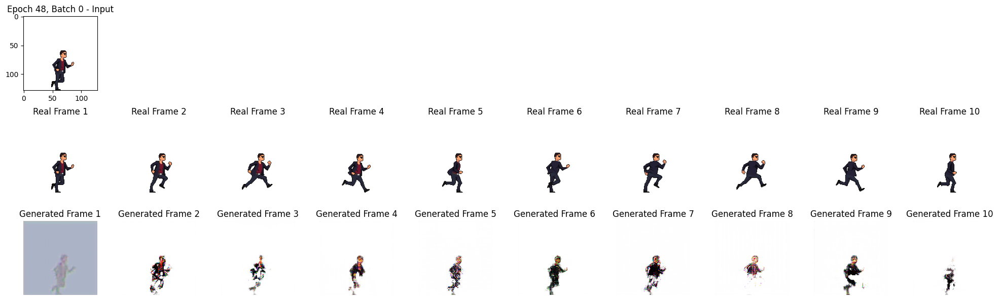

Epoch 49/110


Processing Epoch 49/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.06, Discriminator Loss=1.17]

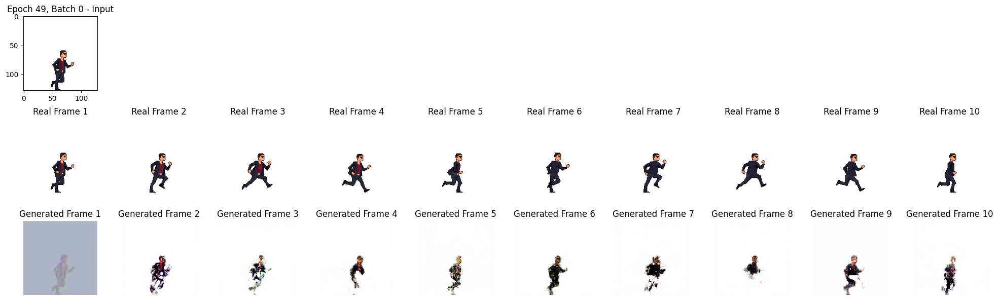

Epoch 50/110


Processing Epoch 50/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.01, Discriminator Loss=1.14]

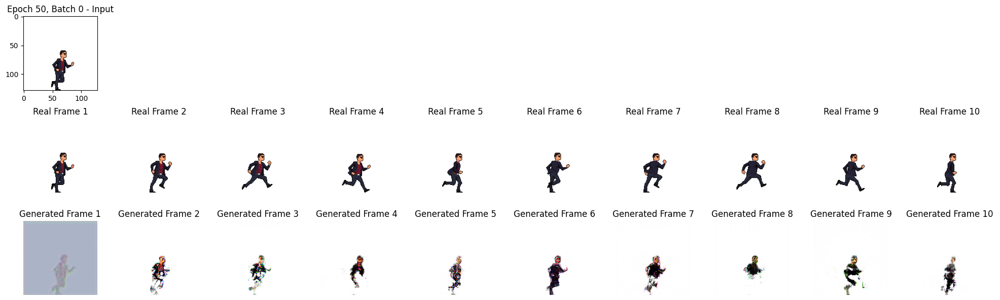

Epoch 51/110


Processing Epoch 51/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.93, Discriminator Loss=1.12]

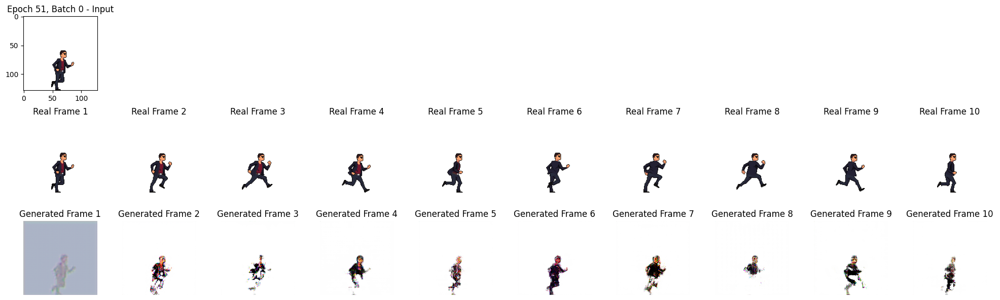

Epoch 52/110


Processing Epoch 52/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.96, Discriminator Loss=1.19]

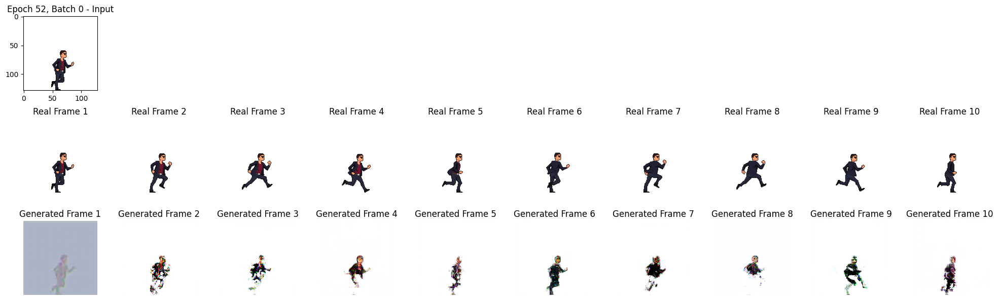

Epoch 53/110


Processing Epoch 53/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.91, Discriminator Loss=1.28]

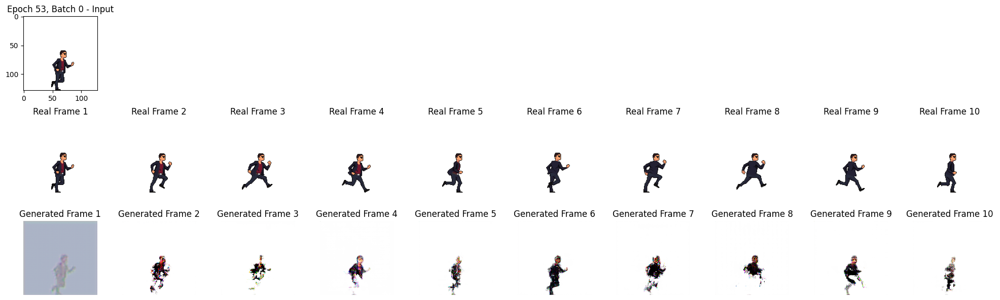

Epoch 54/110


Processing Epoch 54/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=3.03, Discriminator Loss=1.2]

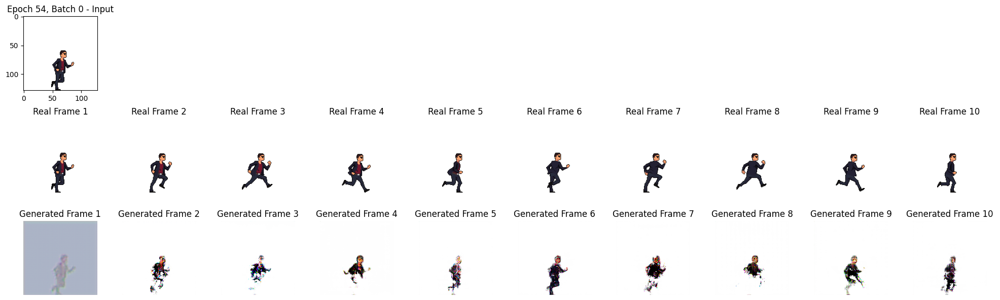

Epoch 55/110


Processing Epoch 55/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.92, Discriminator Loss=1.14]

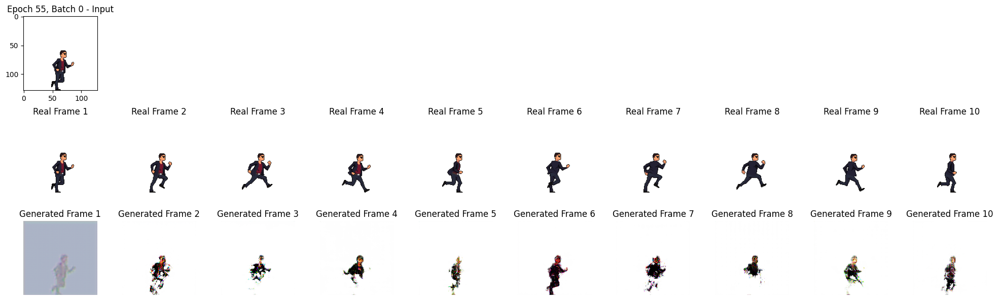

Epoch 56/110


Processing Epoch 56/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.78, Discriminator Loss=1.13]

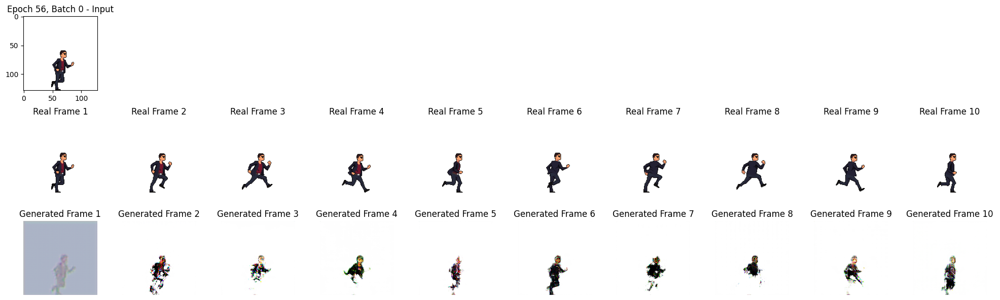

Epoch 57/110


Processing Epoch 57/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.81, Discriminator Loss=1.11]

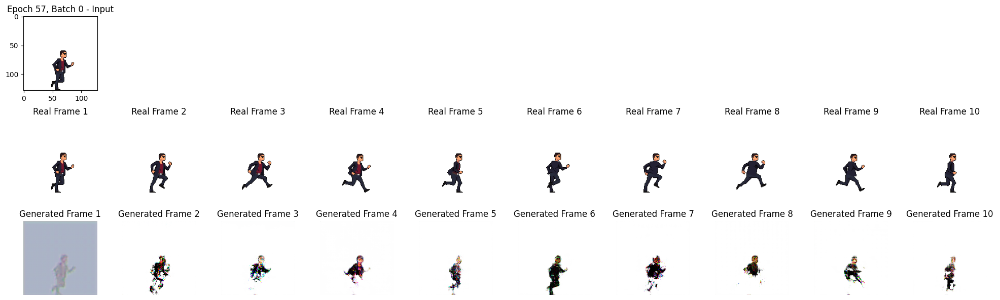

Epoch 58/110


Processing Epoch 58/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.85, Discriminator Loss=1.12]

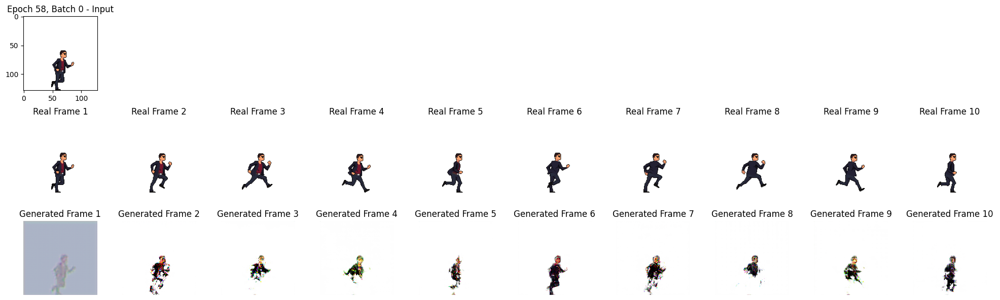

Epoch 59/110


Processing Epoch 59/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.96, Discriminator Loss=1.18]

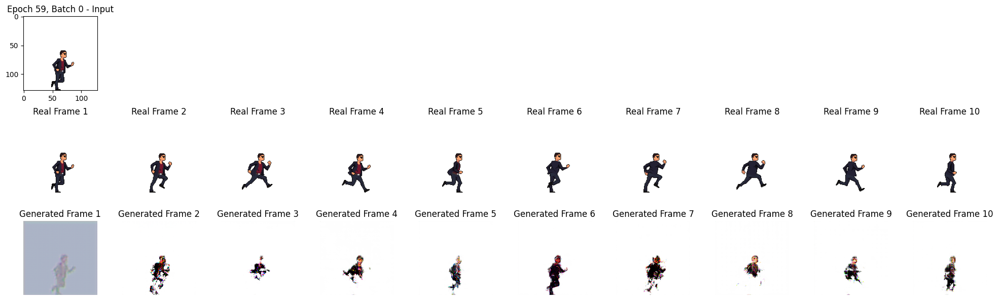

Epoch 60/110


Processing Epoch 60/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.7, Discriminator Loss=1.11]

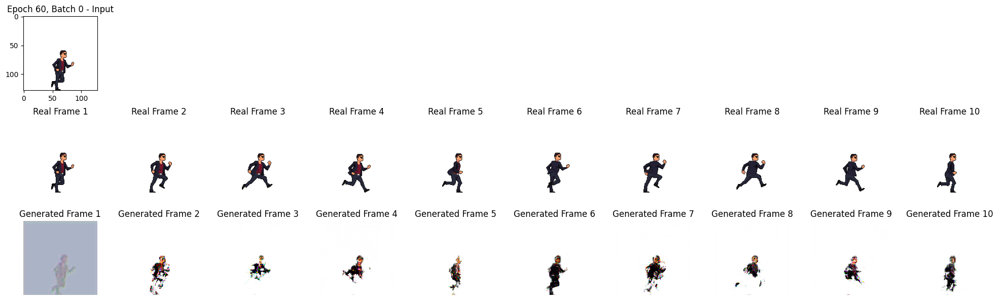

Epoch 61/110


Processing Epoch 61/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.53, Discriminator Loss=1.09]

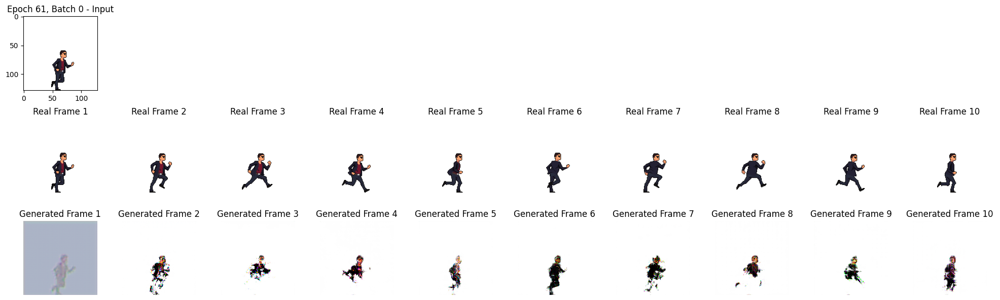

Epoch 62/110


Processing Epoch 62/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.77, Discriminator Loss=1.05]

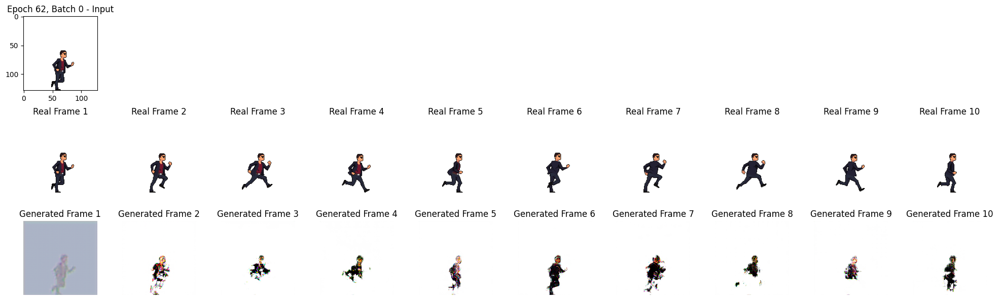

Epoch 63/110


Processing Epoch 63/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.89, Discriminator Loss=1.13]

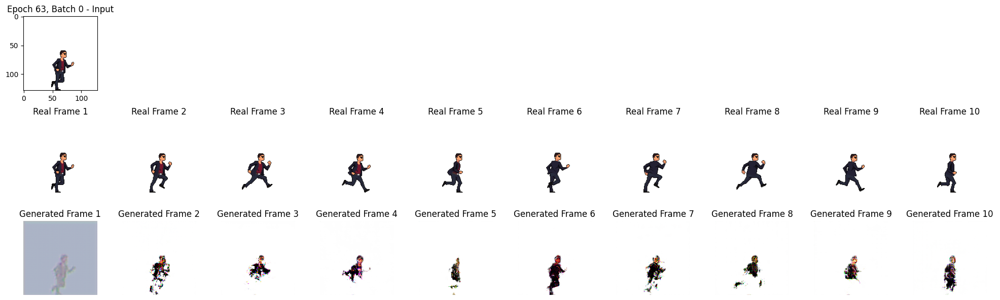

Epoch 64/110


Processing Epoch 64/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.99, Discriminator Loss=1.08]

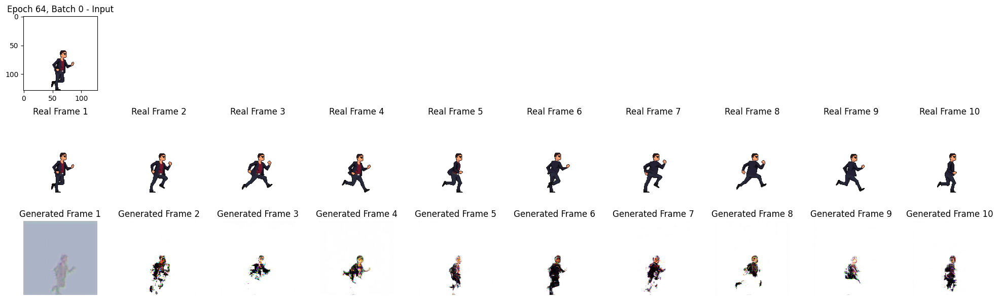

Epoch 65/110


Processing Epoch 65/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.67, Discriminator Loss=1.05]

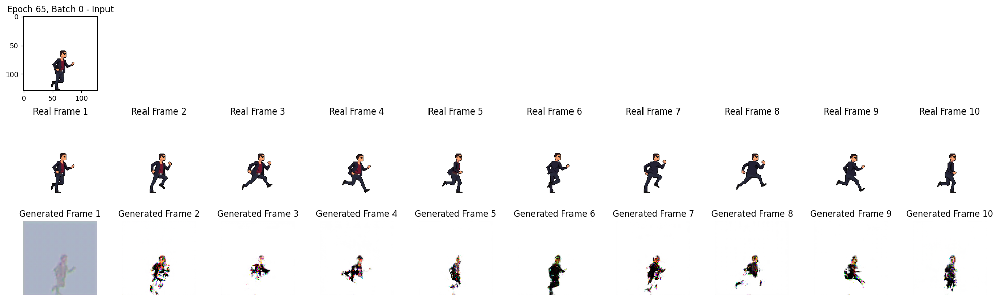

Epoch 66/110


Processing Epoch 66/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.51, Discriminator Loss=1.14]

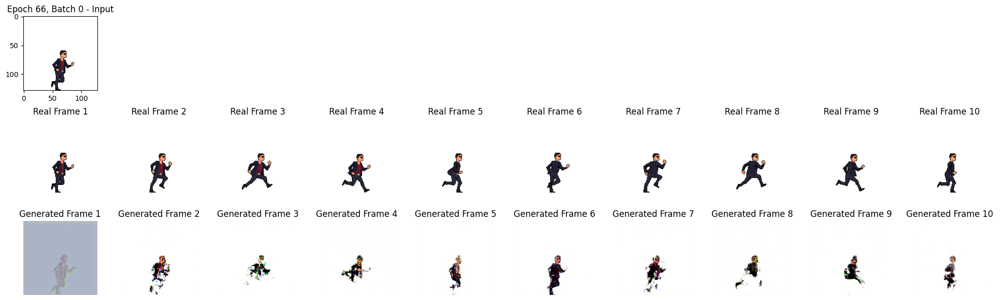

Epoch 67/110


Processing Epoch 67/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.78, Discriminator Loss=1.12]

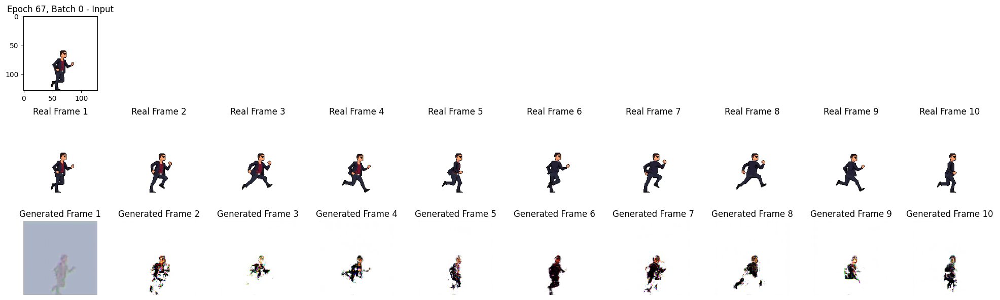

Epoch 68/110


Processing Epoch 68/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.61, Discriminator Loss=1.1]

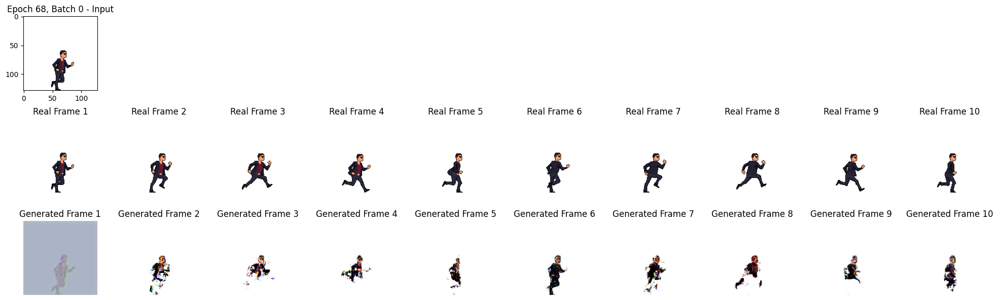

Epoch 69/110


Processing Epoch 69/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.68, Discriminator Loss=1.14]

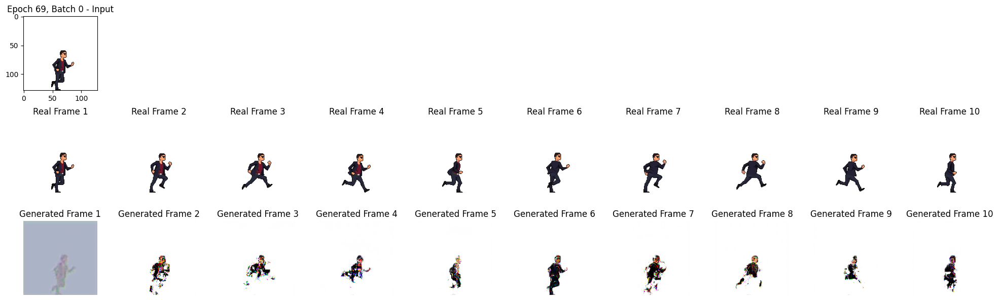

Epoch 70/110


Processing Epoch 70/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.75, Discriminator Loss=1.16]

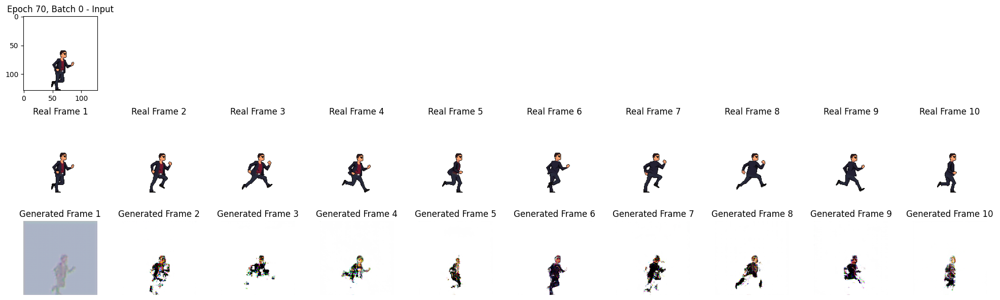

Epoch 71/110


Processing Epoch 71/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.69, Discriminator Loss=1.15]

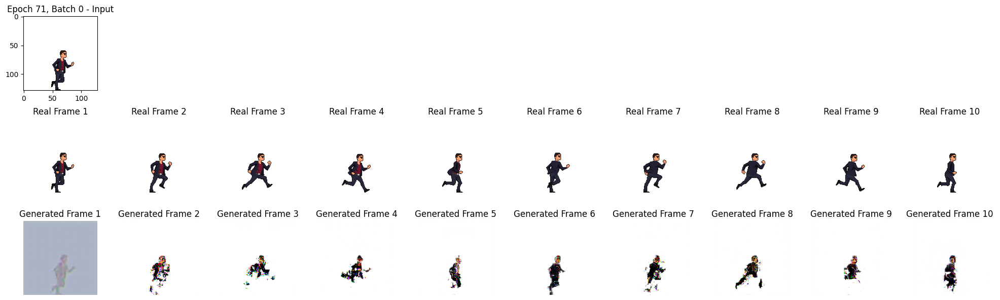

Epoch 72/110


Processing Epoch 72/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.56, Discriminator Loss=1.14]

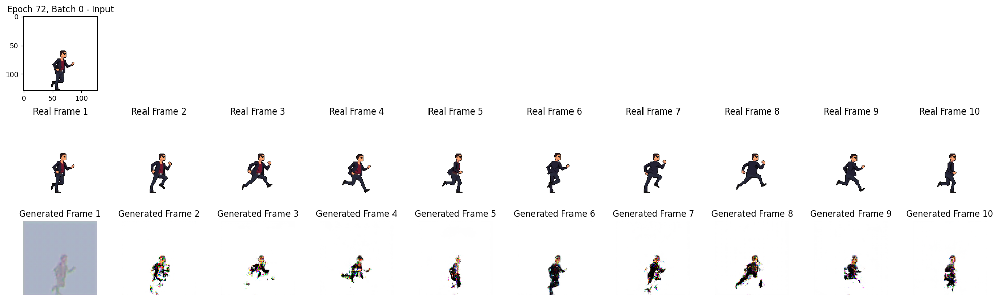

Epoch 73/110


Processing Epoch 73/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.53, Discriminator Loss=1.1]

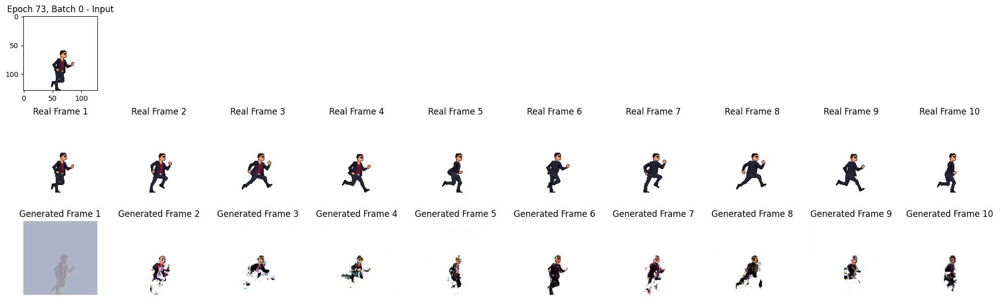

Epoch 74/110


Processing Epoch 74/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.46, Discriminator Loss=1.12]

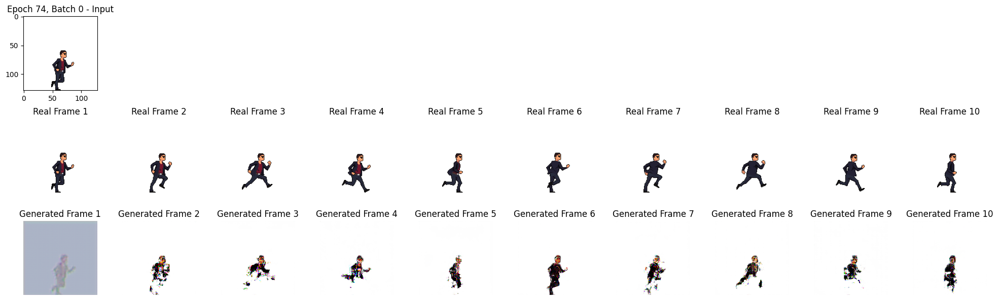

Epoch 75/110


Processing Epoch 75/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.69, Discriminator Loss=1.14]

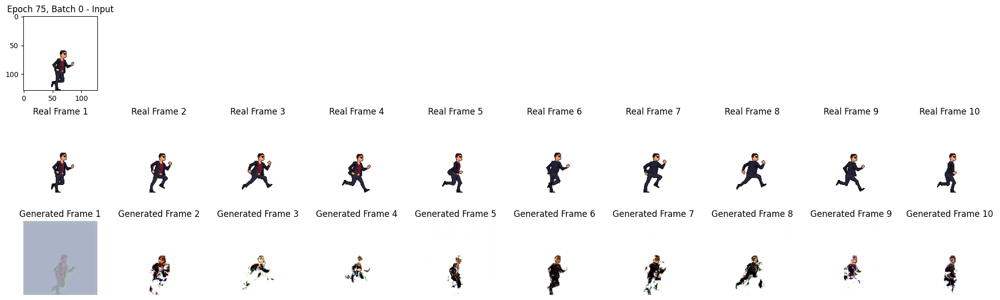

Epoch 76/110


Processing Epoch 76/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.46, Discriminator Loss=1.11]

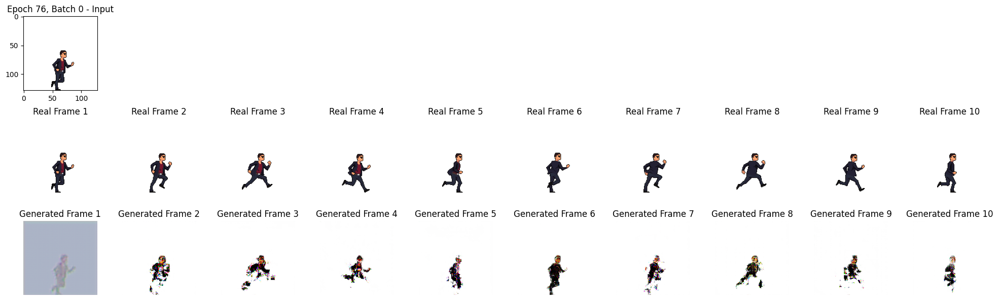

Epoch 77/110


Processing Epoch 77/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.62, Discriminator Loss=1.12]

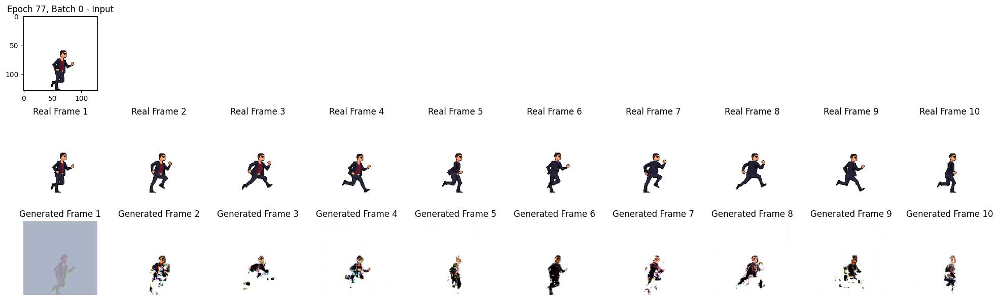

Epoch 78/110


Processing Epoch 78/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.49, Discriminator Loss=1.17]

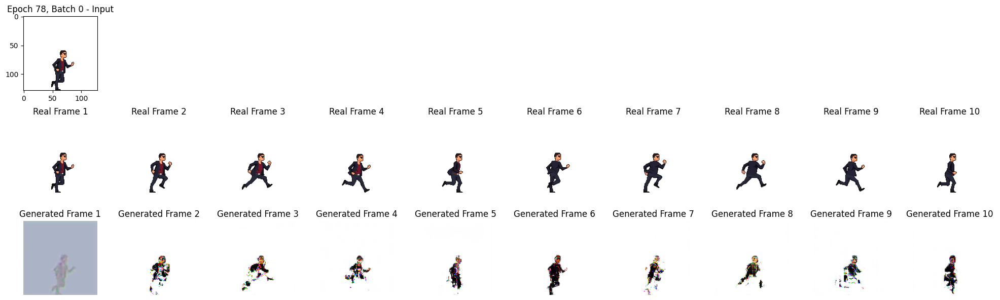

Epoch 79/110


Processing Epoch 79/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.49, Discriminator Loss=1.11]

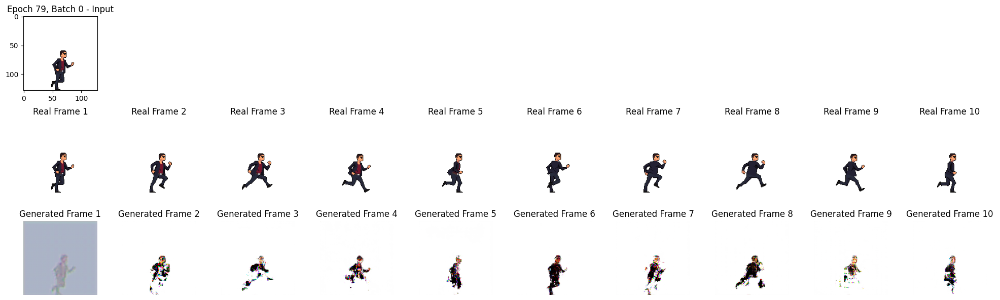

Epoch 80/110


Processing Epoch 80/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.6, Discriminator Loss=1.08]

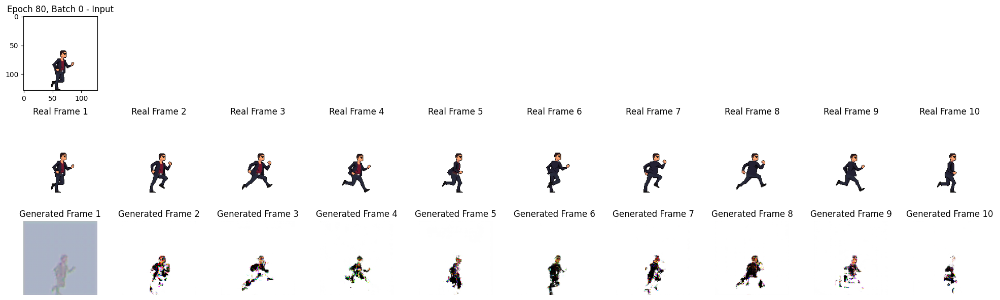

Epoch 81/110


Processing Epoch 81/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.33, Discriminator Loss=1.14]

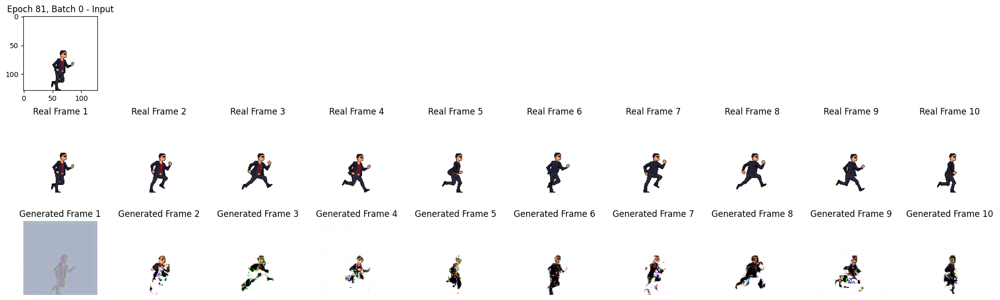

Epoch 82/110


Processing Epoch 82/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.54, Discriminator Loss=1.12]

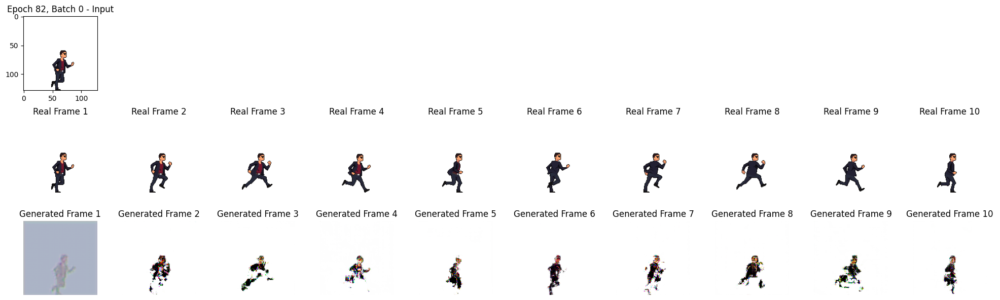

Epoch 83/110


Processing Epoch 83/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.43, Discriminator Loss=1.16]

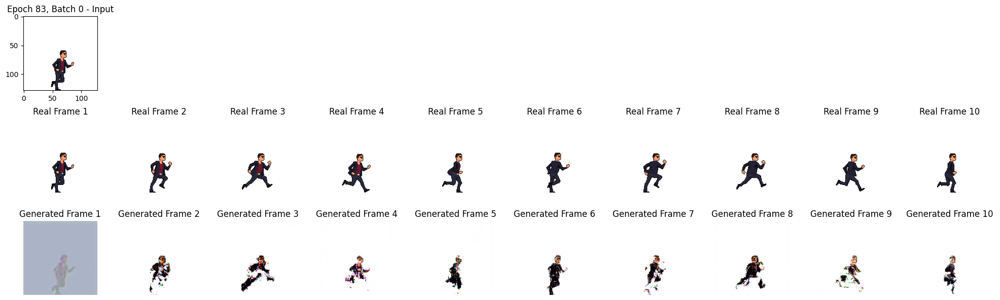

Epoch 84/110


Processing Epoch 84/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.89, Discriminator Loss=1.26]

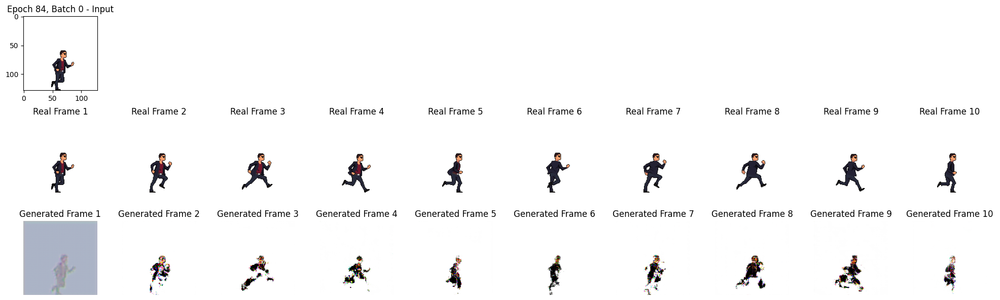

Epoch 85/110


Processing Epoch 85/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.29, Discriminator Loss=1.36]

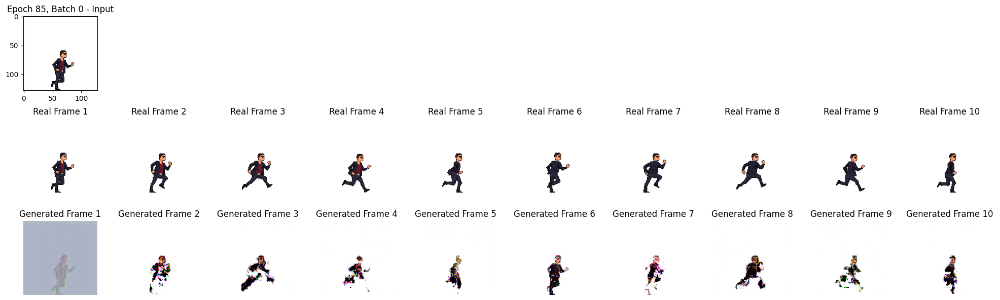

Epoch 86/110


Processing Epoch 86/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.47, Discriminator Loss=1.11]

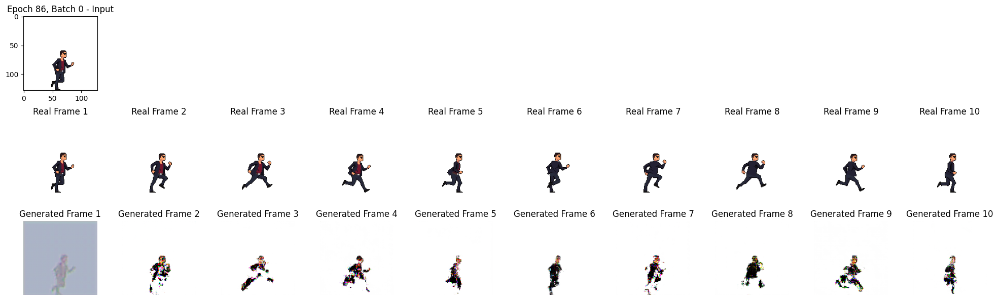

Epoch 87/110


Processing Epoch 87/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.28, Discriminator Loss=1.12]

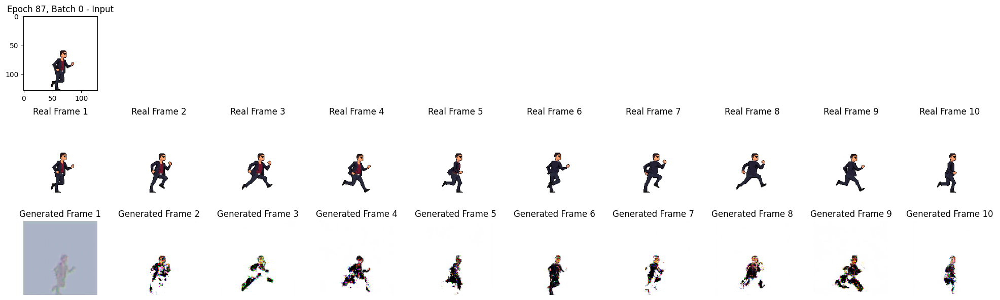

Epoch 88/110


Processing Epoch 88/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.67, Discriminator Loss=1.12]

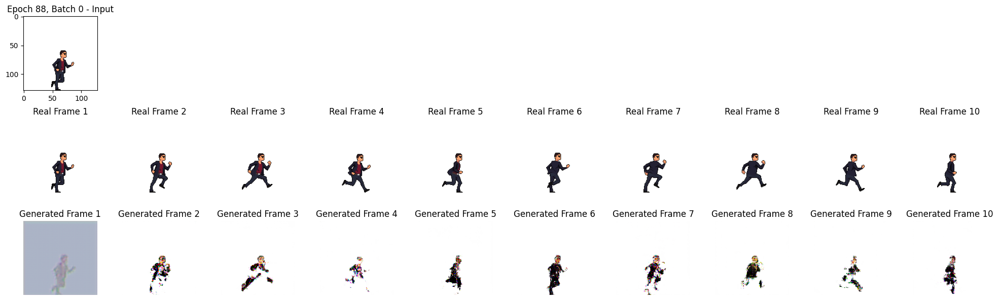

Epoch 89/110


Processing Epoch 89/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.3, Discriminator Loss=1.14]

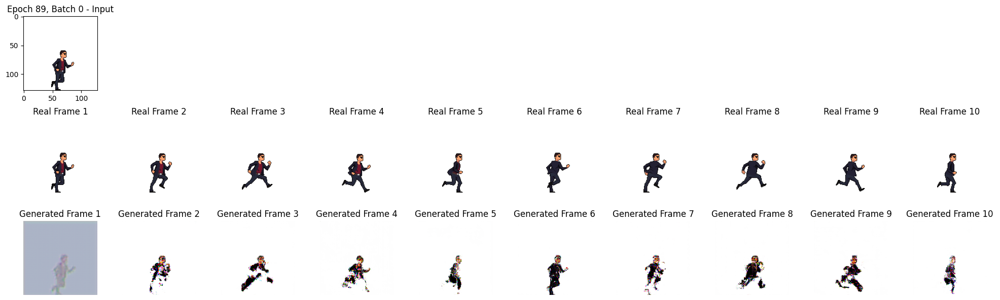

Epoch 90/110


Processing Epoch 90/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.35, Discriminator Loss=1.14]

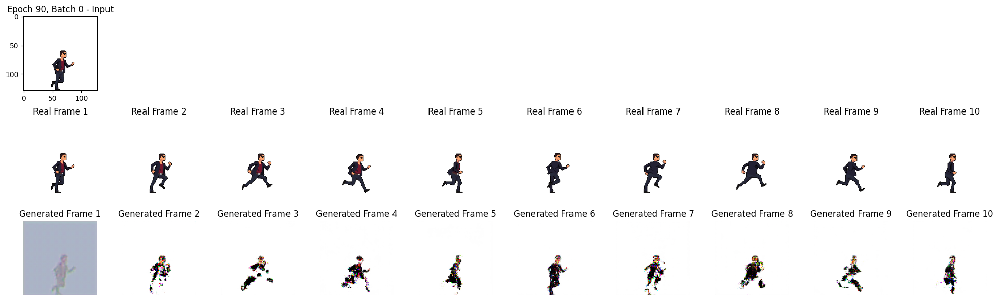

Epoch 91/110


Processing Epoch 91/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.29, Discriminator Loss=1.18]

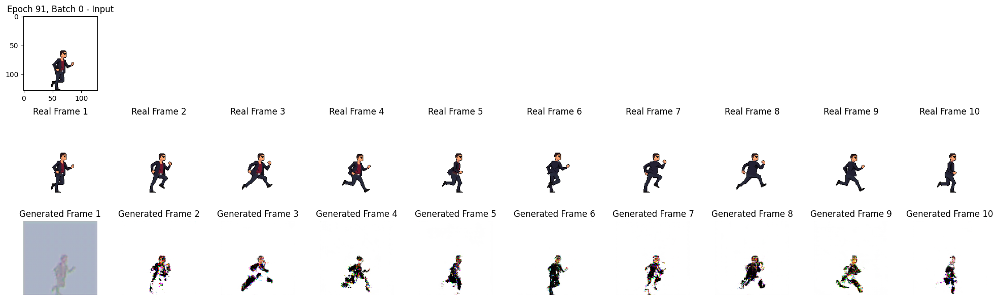

Epoch 92/110


Processing Epoch 92/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.4, Discriminator Loss=1.16]

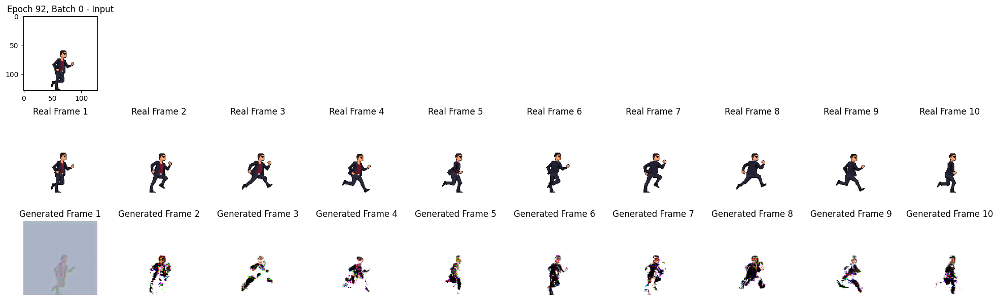

Epoch 93/110


Processing Epoch 93/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.25, Discriminator Loss=1.15]

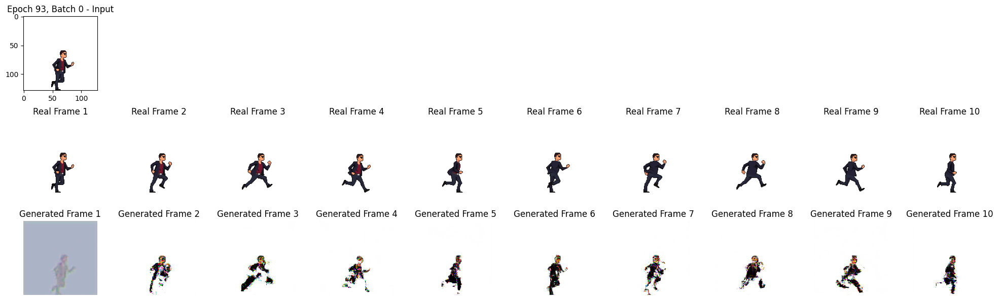

Epoch 94/110


Processing Epoch 94/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.33, Discriminator Loss=1.14]

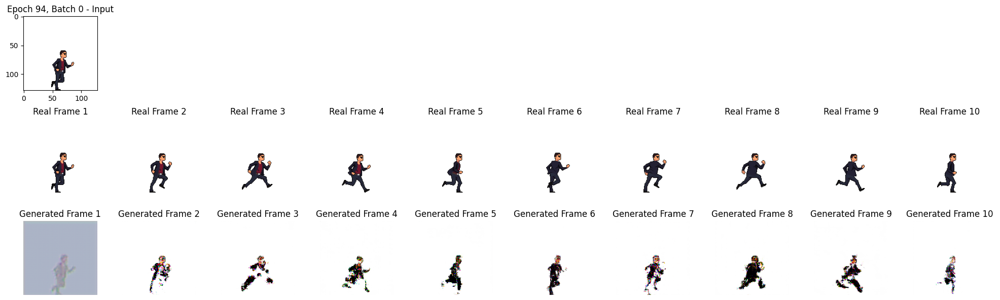

Epoch 95/110


Processing Epoch 95/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.32, Discriminator Loss=1.12]

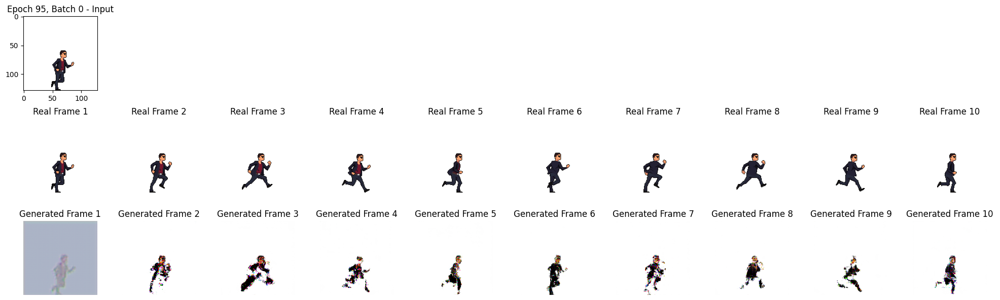

Epoch 96/110


Processing Epoch 96/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.48, Discriminator Loss=1.22]

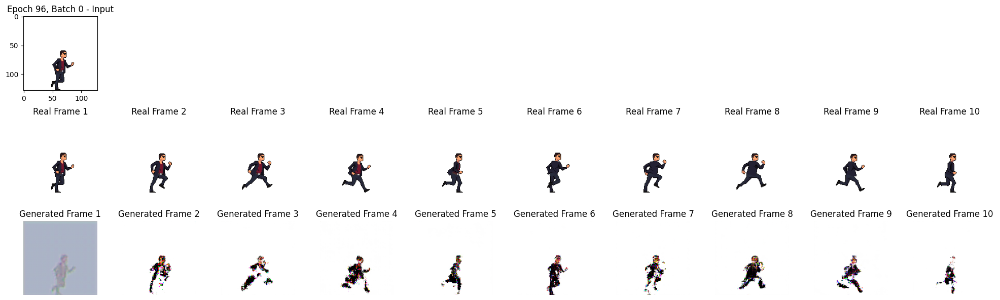

Epoch 97/110


Processing Epoch 97/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.26, Discriminator Loss=1.2]

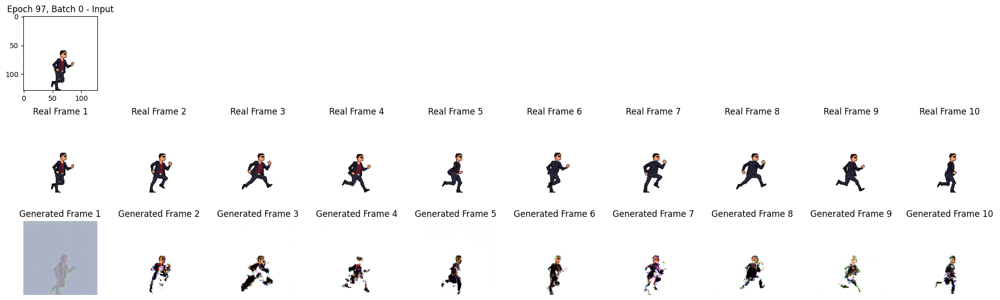

Epoch 98/110


Processing Epoch 98/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.39, Discriminator Loss=1.12]

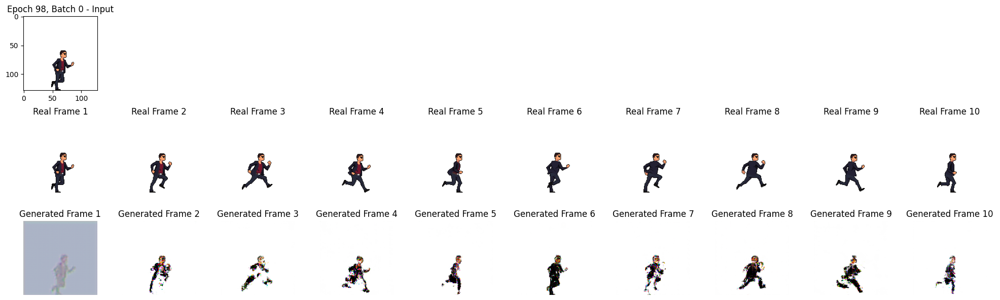

Epoch 99/110


Processing Epoch 99/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.13, Discriminator Loss=1.12]

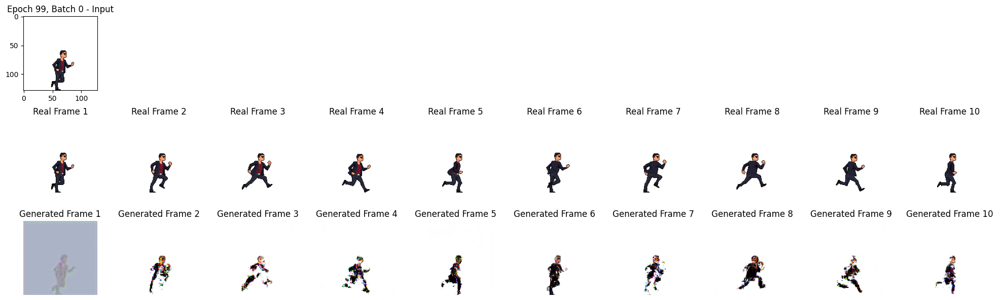

Epoch 100/110


Processing Epoch 100/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.39, Discriminator Loss=1.11]

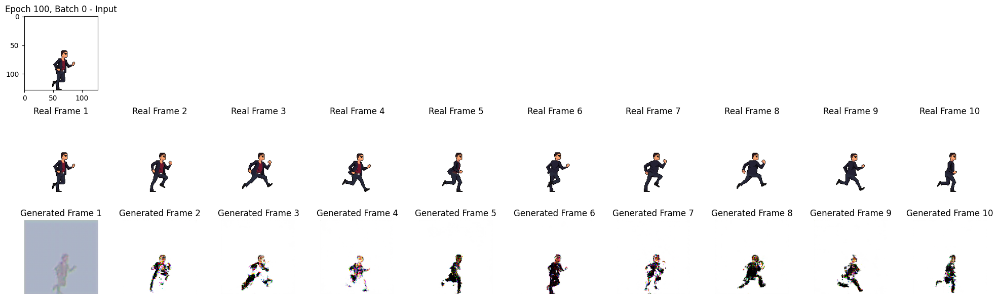

Epoch 101/110


Processing Epoch 101/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.24, Discriminator Loss=1.14]

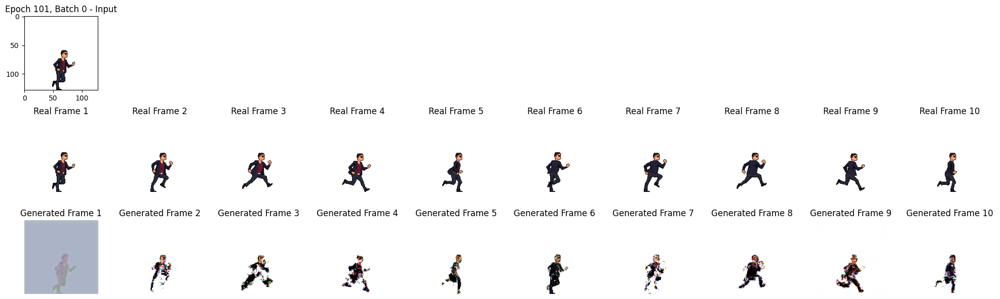

Epoch 102/110


Processing Epoch 102/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.37, Discriminator Loss=1.08]

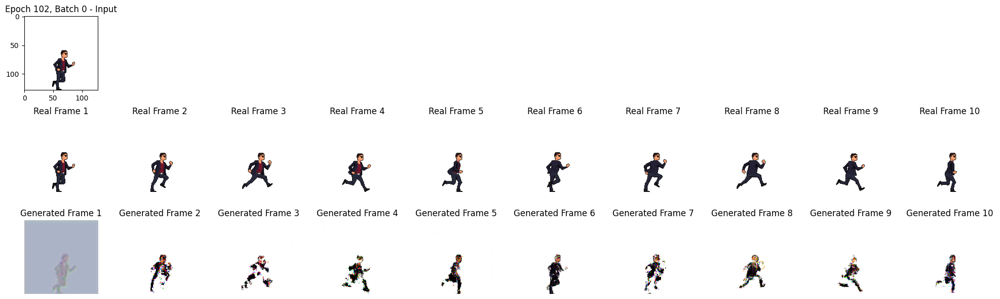

Epoch 103/110


Processing Epoch 103/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.31, Discriminator Loss=1.13]

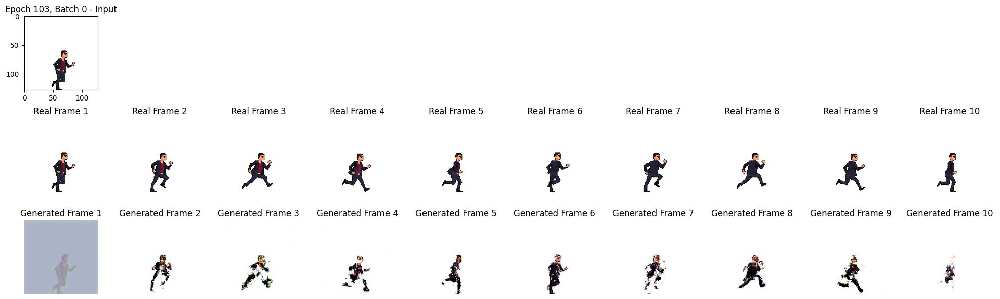

Epoch 104/110


Processing Epoch 104/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.24, Discriminator Loss=1.26]

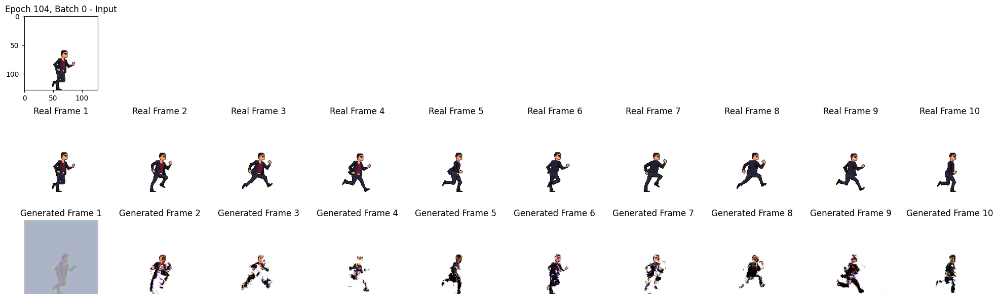

Epoch 105/110


Processing Epoch 105/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.26, Discriminator Loss=1.19]

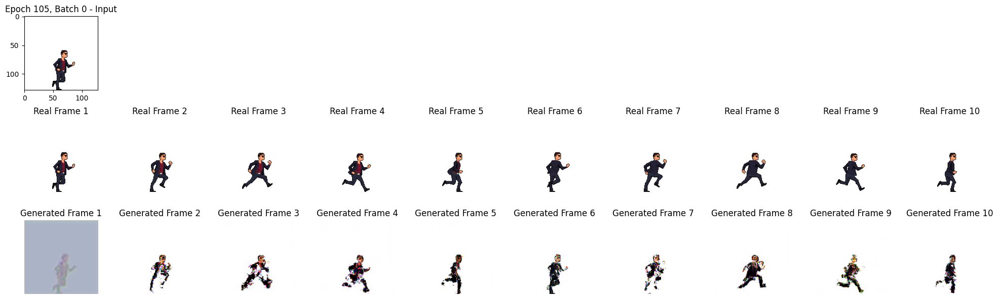

Epoch 106/110


Processing Epoch 106/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.26, Discriminator Loss=1.15]

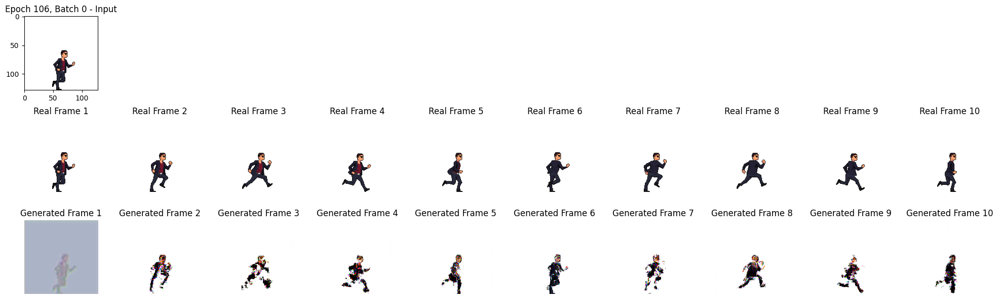

Epoch 107/110


Processing Epoch 107/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.16, Discriminator Loss=1.21]

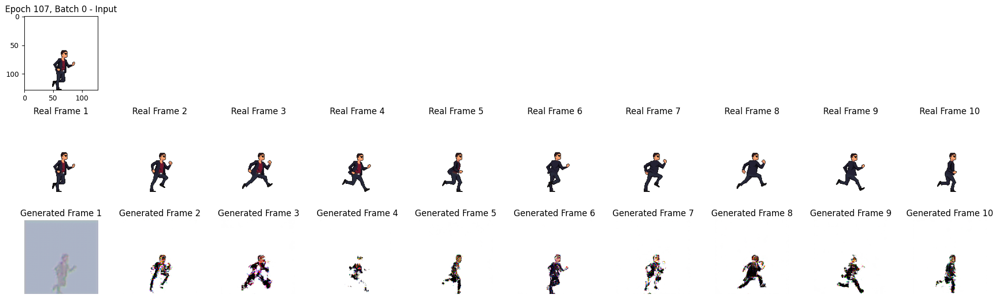

Epoch 108/110


Processing Epoch 108/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.29, Discriminator Loss=1.13]

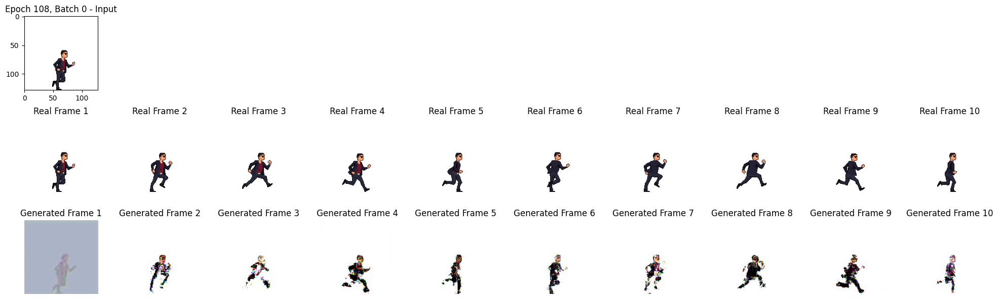

Epoch 109/110


Processing Epoch 109/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.05, Discriminator Loss=1.19]

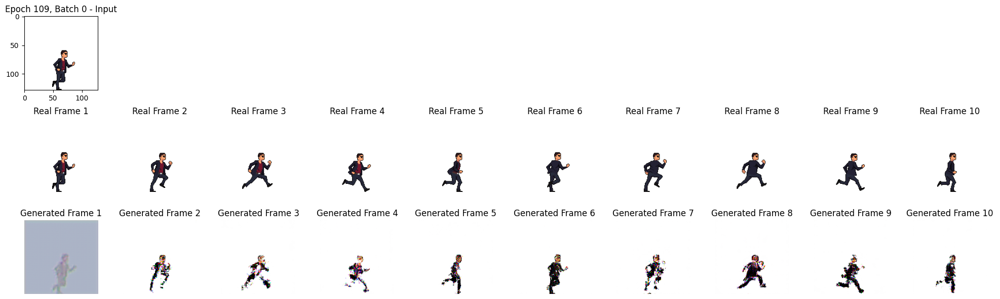

Epoch 110/110


Processing Epoch 110/110:   0%|          | 0/5 [00:08<?, ?it/s, Generator Loss=2.38, Discriminator Loss=1.15]

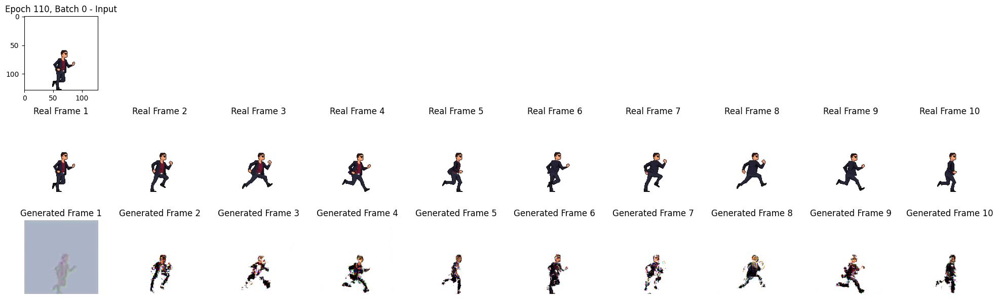

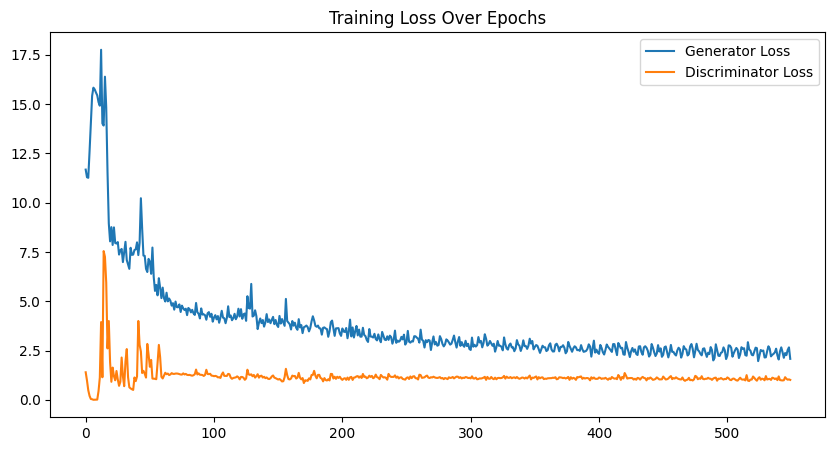

In [33]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

if tf.config.list_physical_devices('GPU'):
    with tf.device('/GPU:0'):
        # 모델 초기화
        sequence_length = 10
        generators = [Ayo_Generator(sequence_length=1) for _ in range(sequence_length)]
        discriminators = [Ayo_Discriminator() for _ in range(num_frames)]
        
        # generators 리스트를 train_gan_per_frame 함수에 전달
        train_gan_per_frame(generators, discriminators, combined_dataset, epochs=110, target_frames=10)
else:
    print('NO GPU')